# Predicting Alzheimer’s disease risk factors from the variant fingerprints of non-AD genes

<b>Institution: Johns Hopkins University<br>
Course: EN.588.680 (Foundations of Computational Biology and Bioinformatics)<br>
Instructor: Dr. Rachel Karchin<br>
Presenter: Jong Shin<br>
Date: 05/01/2020<br></b>

## <u>Introduction</u>

Alzheimer’s Disease (AD) is a progressive neurodegenerative disease that is characterized by impaired cognitive domain of brain function. As of 2017, it is a 6th leading cause of death in the U.S., and the typical life expectancy after diagnosis is only about 4 to 8 years.[1] The worst part lies in the fact that there still has not been any effective treatments developed for this disease that has been known for over 100 years. This is partly due to its complex genetic components involved in AD.[2] As a result, despite numerous speculations, a clear mechanism of AD has yet to be discovered. Nonetheless, many studies have suggested multiple genes associated with the disease phenotypes.[3] This project aims to further expend the list of relevant genes/variants most prevalent in people with high number of genetic risk factors. Also, using the analyzed dataset, the risk scores, a combined number of AD risk factors, were predicted using machine learning algorithms.

## <u>Dataset</u>

A total of 862 genetic samples (23andme files) were acquired from either openSNP and Personal Genome Project. The dataset was first analyzed and annotated by openCRAVAT using 8 annotators. Subsequently, genomic variants associated with AD in accordance with the ClinVar database were labeled as risk factors for AD.

## <u>Methods</u>

A total of 862 samples were acquired from either openSNP and Personal Genome Project. The dataset was first analyzed and annotated by openCRAVAT using 8 annotators.[4] Subsequently, the genomic variants associated with AD in accordance with the ClinVar database were labeled as risk factors for AD. Annotated results were reorganized to extract information with respect to these risk factors. Initially, a list of genetic variants co-occurred with the risk factors was generated.[5] Those genetic variants were converted into their corresponding genes. Using these metrics, frequencies of the variant occurrence within the gene was measured. After removal of AD variants from the analysis, the finalized training set was fed into two machine learning algorithms, namely support vector regression and stochastic gradient descent classifier, for regression and classification, respectively. 

## <u>Results</u>

Of the 17761 distinct variants that could be found in ClinVar database, 32 AD variants were identified and used as risk factors. These are variants of the following genes: APOE, PSEN1/2, APP, PRNP, A2M, TNF, NOS3, HFE, TF, ADAM10, LRRK2.[6] After screening for AD risk factors, 659 samples that carried at least one AD variant were selected for analysis. As expected, there were substantially high number of variants in some genes that are common in most of the samples, which is described as “background.” Top 10 common variants were subtracted from the analysis which consisted of APC, SYNE1, TTN, RYR2, etc. Subsequently, samples with 5 risk factors and higher were selected as a high risk group. 352 and 307 samples were found to be high and low risk groups respectively. Next, parsed dataset was transformed into a training set for SVR and SGD predictors. SVR compared to SGD performed much better in every aspect. Lastly, the list of genes highly associated with high risk users was visualized by Manhattan plot. Here, in order to present at optimal scale of y-axis, threshold was readjusted to 8.

## <u>Implications</u>

It is evident there are many genes associated with genetic risk factors of AD. More than 10 highly prevalent genes could be found in Manhattan plot. CHST3, for instance, is known for its correlation with AD related hearing loss.[7] Though this analysis must follow further exploration, it is interesting to see a stark difference in number of genetic variants between high and low risk groups. Even at higher and lower threshold, the pattern was not different. Only the range of y-axis was affected by the change of threshold. Also, despite the simplicity of features being trained by ML algorithms, the performance by SVR was surprisingly excellent. This further corroborates the main hypothesis of certain patterns of variants associated with AD risk factors. 

In [1]:
import datetime
datetime.datetime.now().strftime("%a, %d %B %Y %H:%M:%S")

'Thu, 30 April 2020 14:02:30'

In [2]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
from os import listdir
from collections import Counter
from IPython.display import clear_output
from sklearn.model_selection import train_test_split

In [3]:
#Global variables
NUM_OF_COMMON_VARIANTS = 10
RISK_GENE_THRESHOLD = 5 #num of risk gene screened out
NUM_OF_TOP_PREV = 10 #num of top prevalence to be removed

#Global settings
pd.set_option('max_columns', None)
pd.set_option('max_rows', 100)

In [4]:
#checking for corrupted 23andme files (25 files removed, 848 left)
DIR = "genome" 

filelist = [f for f in listdir(DIR)]
scr_list = []

for i in range(len(filelist)):
    
    filename = os.path.join(DIR, filelist[i])
    
    f = open(filename, "r")
    l = f.readline()
    f.close()
    
    if l.count("This data file generated by 23andMe") == 0:
        
        scr_list.append(filename)
        f.close()
        os.remove(filename)
        
    print("{:<3}: {:<50} {:>50}".format(i, filename[7:45], l[:50]))

scr_list

0  : 12_Apr2015_All_DNA_Full_download.txt               # This data file generated by 23andMe at: Sun Apr 
1  : 20110124213651.txt                                 # This data file generated by 23andMe at: Mon Jan 
2  : 20110211 23andMe.txt                               # This data file generated by 23andMe at: Fri Feb 
3  : 20140624155119.txt                                 # This data file generated by 23andMe at: Tue Jun 
4  : 20141117101125-23andme-genotype.txt                # This data file generated by 23andMe at: Mon Nov 
5  : 2017-04-29_23andMe_data.txt                        # This data file generated by 23andMe at: Sat Apr 
6  : 23&Me Genome - Raw Data..txt                       # This data file generated by 23andMe at: Sun Jun 
7  : 23&MeRawDataExtracted.txt                          # This data file generated by 23andMe at: Tue Jun 
8  : 23&me_data_for_hu1A8107.txt                        # This data file generated by 23andMe at: Wed Mar 
9  : 23&Me_Genotyping.txt            

278: genome_Full_20131001214624.txt                     # This data file generated by 23andMe at: Tue Oct 
279: genome_Full_20131028233806.txt                     # This data file generated by 23andMe at: Mon Oct 
280: genome_Full_20131029192030.txt                     # This data file generated by 23andMe at: Tue Oct 
281: genome_Full_20131118115943.txt                     # This data file generated by 23andMe at: Mon Nov 
282: genome_Full_20131123201952.txt                     # This data file generated by 23andMe at: Sat Nov 
283: genome_Full_20131125142049.txt                     # This data file generated by 23andMe at: Mon Nov 
284: genome_Full_20131207155813.txt                     # This data file generated by 23andMe at: Sat Dec 
285: genome_Full_20131209133544.txt                     # This data file generated by 23andMe at: Mon Dec 
286: genome_Full_20140126181553.txt                     # This data file generated by 23andMe at: Sun Jan 
287: genome_Full_20140202112527.txt  

580: genome_Ramona_Bates_Full_2013031313411             # This data file generated by 23andMe at: Wed Mar 
581: genome_rarobins_v4_Full_20170424070315             # This data file generated by 23andMe at: Mon Apr 
582: genome_rebecca_boone_Full_201301302053             # This data file generated by 23andMe at: Wed Jan 
583: genome_Rebekah_Canada_Full_20110726143             # This data file generated by 23andMe at: Tue Jul 
584: genome_ReNae_Deal_v4_Full_201708171201             # This data file generated by 23andMe at: Thu Aug 
585: genome_renamed_Full_20150121062926.txt             # This data file generated by 23andMe at: Wed Jan 
586: genome_Rhonda_Lea_Kirk_Fries_Full_2013             # This data file generated by 23andMe at: Sat Jun 
587: genome_Richard_Fritts_Full_20140310035             # This data file generated by 23andMe at: Mon Mar 
588: genome_Richard_Geist_v4_Full_201805061             # This data file generated by 23andMe at: Sun May 
589: genome_Richard_Klein_Full_201107

[]

In [5]:
def find_index(df, key):
    
    results = []
    
    for i in range(len(df)):
        if df[i] == key:
            results.append(i)
    
    return results

def progress(df, i):
    #progress report moves by column
    clear_output(wait=True)
    if len(df.columns) > 1:
        print(df.columns.get_loc(i) / (len(df.columns)-1) * 100, "% completed")
    else:
        print("100% completed")

def load_dataset(all):
    
    if all is True: #for the complete dataset
        predf1 = pd.read_excel("annotations/200414-024836_variant.xlsx") #14
        predf2 = pd.read_excel("annotations/200418-202712_variant.xlsx") #100
        predf3 = pd.read_excel("annotations/200419-023416_variant.xlsx") #100
        predf4 = pd.read_excel("annotations/200419-070726_variant.xlsx") #100
        predf5 = pd.read_excel("annotations/200419-150332_variant.xlsx") #200
        predf6 = pd.read_excel("annotations/200426-110423_variant.xlsx") #348

        predt1 = pd.read_excel("annotations/test_file.xlsx") #test only
        
        return pd.concat([predf1, predf2, predf3, predf4, predf5, predf6]) # 862
        #return pd.concat([predt1, predt])
    
    else:
        return pd.read_excel("annotations/200418-202712_variant.xlsx")

In [6]:
%%time
df = load_dataset(True)
df

Wall time: 37.3 s


,UID,Chrom,Position,Ref_Base,Alt_Base,Coding,Hugo,Transcript,Sequence_Ontology,Protein_Change,All_Mappings,Sample_Count,Samples,Tags,Chrom.1,Position.1,Clinical_Significance,Disease_Ref Nums,Disease_Names,Review_Status,ClinVar_ID,Transcript_ID,Protein_ID,Score,Converted_Rank Score,Prediction,Term,ID,GO_Name,Full_Aspects,Aspects,Reference,Evidence_Code,Global_AF,NHLBI_Key,PMID,Phenotype,Prediction.1,Score.1,FDR,Uniprot,HDIV_Raw Score,HDIV_Rank Score,HDIV_Prediction,HVAR_Raw Score,HVAR_Rank Score,HVAR_Prediction,Zygosity,Note,African_AF,American_AF,Ashkenazi_Jewish AF,East_Asian AF,Finnish_AF,Non-Fin_Eur AF,Other_AF,South_Asian AF,Chemical,Chemical_ID,Study,Phenotype_Category,Significance,Notes,Description
0,20,chr1,1042400,C,T,NaN,AGRN,ENST00000620552.4,intron,NaN,"{""AGRN"":[[null,null,""intron"",""ENST00000379370....",12,1075.23andme.550;5917.23andme.4386;6120.23andm...,rs2710875,chr1,977780,Benign,MedGen:CN517202,not provided,"criteria provided, single submitter",677947,NaN,NaN,NaN,NaN,NaN,Agrin,GO:0001523;GO:0002162;GO:0005200;GO:0005201;GO...,retinoid metabolic process;dystroglycan bindin...,P;F;F;F;F;F;F;F;F;F;C;C;C;C;C;C;C;C;C;C;C;C;C;...,"C,F,P",Reactome:R-HSA-975634;GO_REF:0000024;PMID:9652...,TAS;ISS;TAS;HDA;HDA;HDA;HDA;ISS;IPI;IPI;TAS;TA...,0.807,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,hom;het;het;hom;hom;hom;hom;hom;hom;hom;het;hom,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,319,chr1,3396350,T,G,NaN,PRDM16,ENST00000270722.9,intron,NaN,"{""PRDM16"":[[""Q9HAZ2"",null,""intron"",""ENST000002...",5,1075.23andme.550;9486.23andme.7780;user304623a...,rs871822,chr1,3312914,Benign,MedGen:CN517202,not provided,"criteria provided, single submitter",674709,NaN,NaN,NaN,NaN,NaN,PR domain zinc finger protein 16,GO:0000122;GO:0000981;GO:0003713;GO:0005515;GO...,negative regulation of transcription by RNA po...,P;F;F;F;C;C;C;C;C;C;C;F;P;P;P;F;P;P;P;F;P;P;P;...,"C,F,P",PMID:19049980;GO_REF:0000113;GO_REF:0000024;PM...,IDA;ISA;ISS;IPI;IDA;IDA;IDA;IDA;TAS;IDA;ISS;TA...,0.380,21886157624404|19875103624402|19197363624400|2...,21886157|19875103|19197363|20339536|22451204|1...,Serum ratio of (2-oleoylglycerophosphocholine*...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,het;het;hom;het;het,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,325,chr1,3411794,T,C,Yes,PRDM16,ENST00000270722.9,missense,S533P,"{""PRDM16"":[[""Q9HAZ2"",""S533P"",""missense"",""ENST0...",10,1075.23andme.550;5917.23andme.4386;6120.23andm...,AX-39600161;rs870124,chr1,3328358,Benign,"MedGen:C3809288,OMIM:615373|MedGen:CN169374",Left ventricular noncompaction 8|not specified,"criteria provided, multiple submitters, no con...",227026,ENST00000511072;ENST00000378391;ENST0000051418...,ENSP00000426975;ENSP00000367643;ENSP0000042140...,3.38;3.42;3.4;3.41;3.35,0.060,T;T;T;T;T,PR domain zinc finger protein 16,GO:0000122;GO:0000981;GO:0003713;GO:0005515;GO...,negative regulation of transcription by RNA po...,P;F;F;F;C;C;C;C;C;C;C;F;P;P;P;F;P;P;P;F;P;P;P;...,"C,F,P",PMID:19049980;GO_REF:0000113;GO_REF:0000024;PM...,IDA;ISA;ISS;IPI;IDA;IDA;IDA;IDA;TAS;IDA;ISS;TA...,0.891,20383146622445|235855526537215|234556366537214...,20383146|23585552|23455636|20935629|19508998,Chronic kidney disease(1.100e-02)|Primary rheg...,Benign,0.018,0.027,Q9HAZ2-2;Q9HAZ2,0.0;0.0,0.029,B;B,0.0;0.0,0.014,B;B,hom;het;het;het;het;hom;het;het;het;hom;het,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,329,chr1,3426240,G,T,NaN,PRDM16,ENST00000270722.9,intron,NaN,"{""PRDM16"":[[""Q9HAZ2"",null,""intron"",""ENST000002...",5,1075.23andme.550;6120.23andme.4640;9486.23andm...,AX-39602841;rs870171,chr1,3342804,Benign,MedGen:CN169374,not specified,"criteria provided, multiple submitters, no con...",227035,NaN,NaN,NaN,NaN,NaN,PR domain zinc finger protein 16,GO:0000122;GO:0000981;GO:0003713;GO:0005515;GO...,negative regulation of transcription by RNA po...,P;F;F;F;C;C;C;C;C;C;C;F;P;P;P;F;P;P;P;F;P;P;P;...,"C,F,P",PMID:19049980;GO_REF:0000113;GO_REF:00000

In [7]:
#drop NaN in Hugo column
df = df.drop(df[df["Hugo"].isna()].index).reset_index()
df

,index,UID,Chrom,Position,Ref_Base,Alt_Base,Coding,Hugo,Transcript,Sequence_Ontology,Protein_Change,All_Mappings,Sample_Count,Samples,Tags,Chrom.1,Position.1,Clinical_Significance,Disease_Ref Nums,Disease_Names,Review_Status,ClinVar_ID,Transcript_ID,Protein_ID,Score,Converted_Rank Score,Prediction,Term,ID,GO_Name,Full_Aspects,Aspects,Reference,Evidence_Code,Global_AF,NHLBI_Key,PMID,Phenotype,Prediction.1,Score.1,FDR,Uniprot,HDIV_Raw Score,HDIV_Rank Score,HDIV_Prediction,HVAR_Raw Score,HVAR_Rank Score,HVAR_Prediction,Zygosity,Note,African_AF,American_AF,Ashkenazi_Jewish AF,East_Asian AF,Finnish_AF,Non-Fin_Eur AF,Other_AF,South_Asian AF,Chemical,Chemical_ID,Study,Phenotype_Category,Significance,Notes,Description
0,0,20,chr1,1042400,C,T,NaN,AGRN,ENST00000620552.4,intron,NaN,"{""AGRN"":[[null,null,""intron"",""ENST00000379370....",12,1075.23andme.550;5917.23andme.4386;6120.23andm...,rs2710875,chr1,977780,Benign,MedGen:CN517202,not provided,"criteria provided, single submitter",677947,NaN,NaN,NaN,NaN,NaN,Agrin,GO:0001523;GO:0002162;GO:0005200;GO:0005201;GO...,retinoid metabolic process;dystroglycan bindin...,P;F;F;F;F;F;F;F;F;F;C;C;C;C;C;C;C;C;C;C;C;C;C;...,"C,F,P",Reactome:R-HSA-975634;GO_REF:0000024;PMID:9652...,TAS;ISS;TAS;HDA;HDA;HDA;HDA;ISS;IPI;IPI;TAS;TA...,0.807,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,hom;het;het;hom;hom;hom;hom;hom;hom;hom;het;hom,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,319,chr1,3396350,T,G,NaN,PRDM16,ENST00000270722.9,intron,NaN,"{""PRDM16"":[[""Q9HAZ2"",null,""intron"",""ENST000002...",5,1075.23andme.550;9486.23andme.7780;user304623a...,rs871822,chr1,3312914,Benign,MedGen:CN517202,not provided,"criteria provided, single submitter",674709,NaN,NaN,NaN,NaN,NaN,PR domain zinc finger protein 16,GO:0000122;GO:0000981;GO:0003713;GO:0005515;GO...,negative regulation of transcription by RNA po...,P;F;F;F;C;C;C;C;C;C;C;F;P;P;P;F;P;P;P;F;P;P;P;...,"C,F,P",PMID:19049980;GO_REF:0000113;GO_REF:0000024;PM...,IDA;ISA;ISS;IPI;IDA;IDA;IDA;IDA;TAS;IDA;ISS;TA...,0.380,21886157624404|19875103624402|19197363624400|2...,21886157|19875103|19197363|20339536|22451204|1...,Serum ratio of (2-oleoylglycerophosphocholine*...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,het;het;hom;het;het,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,325,chr1,3411794,T,C,Yes,PRDM16,ENST00000270722.9,missense,S533P,"{""PRDM16"":[[""Q9HAZ2"",""S533P"",""missense"",""ENST0...",10,1075.23andme.550;5917.23andme.4386;6120.23andm...,AX-39600161;rs870124,chr1,3328358,Benign,"MedGen:C3809288,OMIM:615373|MedGen:CN169374",Left ventricular noncompaction 8|not specified,"criteria provided, multiple submitters, no con...",227026,ENST00000511072;ENST00000378391;ENST0000051418...,ENSP00000426975;ENSP00000367643;ENSP0000042140...,3.38;3.42;3.4;3.41;3.35,0.060,T;T;T;T;T,PR domain zinc finger protein 16,GO:0000122;GO:0000981;GO:0003713;GO:0005515;GO...,negative regulation of transcription by RNA po...,P;F;F;F;C;C;C;C;C;C;C;F;P;P;P;F;P;P;P;F;P;P;P;...,"C,F,P",PMID:19049980;GO_REF:0000113;GO_REF:0000024;PM...,IDA;ISA;ISS;IPI;IDA;IDA;IDA;IDA;TAS;IDA;ISS;TA...,0.891,20383146622445|235855526537215|234556366537214...,20383146|23585552|23455636|20935629|19508998,Chronic kidney disease(1.100e-02)|Primary rheg...,Benign,0.018,0.027,Q9HAZ2-2;Q9HAZ2,0.0;0.0,0.029,B;B,0.0;0.0,0.014,B;B,hom;het;het;het;het;hom;het;het;het;hom;het,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,329,chr1,3426240,G,T,NaN,PRDM16,ENST00000270722.9,intron,NaN,"{""PRDM16"":[[""Q9HAZ2"",null,""intron"",""ENST000002...",5,1075.23andme.550;6120.23andme.4640;9486.23andm...,AX-39602841;rs870171,chr1,3342804,Benign,MedGen:CN169374,not specified,"criteria provided, multiple submitters, no con...",227035,NaN,NaN,NaN,NaN,NaN,PR domain zinc finger protein 16,GO:0000122;GO:0000981;GO:0003713;GO:0005515;GO...,negative regulation of transcription by RNA po...,P;F;F;F;C;C;C;C;C;C;C;F;P;P;P;F;P;P;P;F;P;P;P;...,"C,F,P",PMID:19049980;GO_REF:000011

In [8]:
def remove_err(dff):
    
    df = dff.copy()
    templist = []
    
    for i in range(len(df['Hugo'])):
        if ':' in str(df.at[i, 'Hugo']):
            print(df.at[i, 'Hugo'], i)
            df = df.drop(i)
    
    df = df.reset_index(drop=True)
    
    return df

def remove_duplicates(dff):
    
    templist = []
    
    df = dff.copy()

    for i in range(len(df["Tags"])):
        
        if i not in templist:
            
            currentlist = df[df.at[i, 'Tags'] == df['Tags']][1:]

            for j in currentlist['Samples']:

                df.at[i, "Samples"] += ";" + j

            templist += list(currentlist.index)
        
        if i/(len(df["Tags"])-1) * 100 % 5 < 0.1: #less laggy
            clear_output(wait=True)
            print(i/(len(df["Tags"])-1) * 100, "% completed")
    
    df = df.drop(templist)
    df = df.reset_index(drop=True)
    
    return remove_err(df)

In [9]:
df[df['Tags'][1] == df['Tags']]

,index,UID,Chrom,Position,Ref_Base,Alt_Base,Coding,Hugo,Transcript,Sequence_Ontology,Protein_Change,All_Mappings,Sample_Count,Samples,Tags,Chrom.1,Position.1,Clinical_Significance,Disease_Ref Nums,Disease_Names,Review_Status,ClinVar_ID,Transcript_ID,Protein_ID,Score,Converted_Rank Score,Prediction,Term,ID,GO_Name,Full_Aspects,Aspects,Reference,Evidence_Code,Global_AF,NHLBI_Key,PMID,Phenotype,Prediction.1,Score.1,FDR,Uniprot,HDIV_Raw Score,HDIV_Rank Score,HDIV_Prediction,HVAR_Raw Score,HVAR_Rank Score,HVAR_Prediction,Zygosity,Note,African_AF,American_AF,Ashkenazi_Jewish AF,East_Asian AF,Finnish_AF,Non-Fin_Eur AF,Other_AF,South_Asian AF,Chemical,Chemical_ID,Study,Phenotype_Category,Significance,Notes,Description
1,1,319,chr1,3396350,T,G,NaN,PRDM16,ENST00000270722.9,intron,NaN,"{""PRDM16"":[[""Q9HAZ2"",null,""intron"",""ENST000002...",5,1075.23andme.550;9486.23andme.7780;user304623a...,rs871822,chr1,3312914,Benign,MedGen:CN517202,not provided,"criteria provided, single submitter",674709,NaN,NaN,NaN,NaN,NaN,PR domain zinc finger protein 16,GO:0000122;GO:0000981;GO:0003713;GO:0005515;GO...,negative regulation of transcription by RNA po...,P;F;F;F;C;C;C;C;C;C;C;F;P;P;P;F;P;P;P;F;P;P;P;...,"C,F,P",PMID:19049980;GO_REF:0000113;GO_REF:0000024;PM...,IDA;ISA;ISS;IPI;IDA;IDA;IDA;IDA;TAS;IDA;ISS;TA...,0.38,21886157624404|19875103624402|19197363624400|2...,21886157|19875103|19197363|20339536|22451204|1...,Serum ratio of (2-oleoylglycerophosphocholine*...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,het;het;hom;het;het,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15923,7522,727471,chr1,3396350,T,G,NaN,PRDM16,ENST00000270722.9,intron,NaN,"{""PRDM16"":[[""Q9HAZ2"",null,""intron"",""ENST000002...",40,2017-04-29_23andMe_data.txt;23&Me_Genotyping.t...,rs871822,chr1,3312914,Benign,MedGen:CN517202,not provided,"criteria provided, single submitter",674709,NaN,NaN,NaN,NaN,NaN,PR domain zinc finger protein 16,GO:0000122;GO:0000981;GO:0003713;GO:0005515;GO...,negative regulation of transcription by RNA po...,P;F;F;F;C;C;C;C;C;C;C;F;P;P;P;F;P;P;P;F;P;P;P;...,"C,F,P",PMID:19049980;GO_REF:0000113;GO_REF:0000024;PM...,IDA;ISA;ISS;IPI;IDA;IDA;IDA;IDA;TAS;IDA;ISS;TA...,0.38,21886157624404|19875103624402|19197363624400|2...,21886157|19875103|19197363|20339536|22451204|1...,Serum ratio of (2-oleoylglycerophosphocholine*...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,het;het;het;het;het;het;het;het;het;hom;het;ho...,NaN,0.397,0.479,0.222,0.613,0.321,0.284,0.333,0.546,NaN,NaN,NaN,NaN,NaN,NaN,NaN
46472,3744,355158,chr1,3396350,T,G,NaN,PRDM16,ENST00000270722.9,intron,NaN,"{""PRDM16"":[[""Q9HAZ2"",null,""intron"",""ENST000002...",68,genome_Full_20150428121806.txt;genome_Full_201...,rs871822,chr1,3312914,Benign,MedGen:CN517202,not provided,"criteria provided, single submitter",674709,NaN,NaN,NaN,NaN,NaN,PR domain zinc finger protein 16,GO:0000122;GO:0000981;GO:0003713;GO:0005515;GO...,negative regulation of transcription by RNA po...,P;F;F;F;C;C;C;C;C;C;C;F;P;P;P;F;P;P;P;F;P;P;P;...,"C,F,P",PMID:19049980;GO_REF:0000113;GO_REF:0000024;PM...,IDA;ISA;ISS;IPI;IDA;IDA;IDA;IDA;TAS;IDA;ISS;TA...,0.38,21886157624404|19875103624402|19197363624400|2...,21886157|19875103|19197363|20339536|22451204|1...,Serum ratio of (2-oleoylglycerophosphocholine*...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,het;het;het;het;het;het;het;het;het;het;het;he...,NaN,0.397,0.479,0.222,0.613,0.321,0.284,0.333,0.546,NaN,NaN,NaN,NaN,NaN,NaN,NaN
59747,4851,1706024,chr1,3396350,T,G,NaN,PRDM16,ENST00000270722.9,intron,NaN,"{""PRDM16"":[[""Q9HAZ2"",null,""intron"",""ENST000002...",97,GenotypingM.txt;LR.txt;MLJ_Genome.txt;My23DNA....,rs871822,chr1,3312914,Benign,MedGen:CN517202,not provided,"criteria provided, single submitter",674709,NaN,NaN,NaN,NaN,NaN,PR domain zinc finger protein 16,NaN,NaN,NaN,NaN,NaN,NaN,0.38,21886157624404|19875103624402|19197363624400|2...,21886157|19875103|19197363|20339536|22451204|1...,Serum ratio of (2-oleoylglycerophosphocholine*...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [10]:
#before the duplicate removal
df["Samples"][1]

'1075.23andme.550;9486.23andme.7780;user304623andme.txt;user585023andme.txt;user685823andme.txt'

In [11]:
%%time
# remove redundent rows from concatenating annotation files in batches
df = remove_duplicates(df)
df

100.0 % completed
2020-09-09 00:00:00 3707
2020-09-09 00:00:00 3708
2020-09-09 00:00:00 3709
2020-09-12 00:00:00 5924
2020-09-09 00:00:00 6511
2020-03-04 00:00:00 6915
2020-09-09 00:00:00 10094
2020-09-09 00:00:00 12298
2020-09-09 00:00:00 12527
2020-09-09 00:00:00 14040
2020-09-09 00:00:00 17590
Wall time: 2min 31s


,index,UID,Chrom,Position,Ref_Base,Alt_Base,Coding,Hugo,Transcript,Sequence_Ontology,Protein_Change,All_Mappings,Sample_Count,Samples,Tags,Chrom.1,Position.1,Clinical_Significance,Disease_Ref Nums,Disease_Names,Review_Status,ClinVar_ID,Transcript_ID,Protein_ID,Score,Converted_Rank Score,Prediction,Term,ID,GO_Name,Full_Aspects,Aspects,Reference,Evidence_Code,Global_AF,NHLBI_Key,PMID,Phenotype,Prediction.1,Score.1,FDR,Uniprot,HDIV_Raw Score,HDIV_Rank Score,HDIV_Prediction,HVAR_Raw Score,HVAR_Rank Score,HVAR_Prediction,Zygosity,Note,African_AF,American_AF,Ashkenazi_Jewish AF,East_Asian AF,Finnish_AF,Non-Fin_Eur AF,Other_AF,South_Asian AF,Chemical,Chemical_ID,Study,Phenotype_Category,Significance,Notes,Description
0,0,20,chr1,1042400,C,T,NaN,AGRN,ENST00000620552.4,intron,NaN,"{""AGRN"":[[null,null,""intron"",""ENST00000379370....",12,1075.23andme.550;5917.23andme.4386;6120.23andm...,rs2710875,chr1,977780,Benign,MedGen:CN517202,not provided,"criteria provided, single submitter",677947,NaN,NaN,NaN,NaN,NaN,Agrin,GO:0001523;GO:0002162;GO:0005200;GO:0005201;GO...,retinoid metabolic process;dystroglycan bindin...,P;F;F;F;F;F;F;F;F;F;C;C;C;C;C;C;C;C;C;C;C;C;C;...,"C,F,P",Reactome:R-HSA-975634;GO_REF:0000024;PMID:9652...,TAS;ISS;TAS;HDA;HDA;HDA;HDA;ISS;IPI;IPI;TAS;TA...,0.807,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,hom;het;het;hom;hom;hom;hom;hom;hom;hom;het;hom,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,319,chr1,3396350,T,G,NaN,PRDM16,ENST00000270722.9,intron,NaN,"{""PRDM16"":[[""Q9HAZ2"",null,""intron"",""ENST000002...",5,1075.23andme.550;9486.23andme.7780;user304623a...,rs871822,chr1,3312914,Benign,MedGen:CN517202,not provided,"criteria provided, single submitter",674709,NaN,NaN,NaN,NaN,NaN,PR domain zinc finger protein 16,GO:0000122;GO:0000981;GO:0003713;GO:0005515;GO...,negative regulation of transcription by RNA po...,P;F;F;F;C;C;C;C;C;C;C;F;P;P;P;F;P;P;P;F;P;P;P;...,"C,F,P",PMID:19049980;GO_REF:0000113;GO_REF:0000024;PM...,IDA;ISA;ISS;IPI;IDA;IDA;IDA;IDA;TAS;IDA;ISS;TA...,0.380,21886157624404|19875103624402|19197363624400|2...,21886157|19875103|19197363|20339536|22451204|1...,Serum ratio of (2-oleoylglycerophosphocholine*...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,het;het;hom;het;het,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,325,chr1,3411794,T,C,Yes,PRDM16,ENST00000270722.9,missense,S533P,"{""PRDM16"":[[""Q9HAZ2"",""S533P"",""missense"",""ENST0...",10,1075.23andme.550;5917.23andme.4386;6120.23andm...,AX-39600161;rs870124,chr1,3328358,Benign,"MedGen:C3809288,OMIM:615373|MedGen:CN169374",Left ventricular noncompaction 8|not specified,"criteria provided, multiple submitters, no con...",227026,ENST00000511072;ENST00000378391;ENST0000051418...,ENSP00000426975;ENSP00000367643;ENSP0000042140...,3.38;3.42;3.4;3.41;3.35,0.060,T;T;T;T;T,PR domain zinc finger protein 16,GO:0000122;GO:0000981;GO:0003713;GO:0005515;GO...,negative regulation of transcription by RNA po...,P;F;F;F;C;C;C;C;C;C;C;F;P;P;P;F;P;P;P;F;P;P;P;...,"C,F,P",PMID:19049980;GO_REF:0000113;GO_REF:0000024;PM...,IDA;ISA;ISS;IPI;IDA;IDA;IDA;IDA;TAS;IDA;ISS;TA...,0.891,20383146622445|235855526537215|234556366537214...,20383146|23585552|23455636|20935629|19508998,Chronic kidney disease(1.100e-02)|Primary rheg...,Benign,0.018,0.027,Q9HAZ2-2;Q9HAZ2,0.0;0.0,0.029,B;B,0.0;0.0,0.014,B;B,hom;het;het;het;het;hom;het;het;het;hom;het,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,329,chr1,3426240,G,T,NaN,PRDM16,ENST00000270722.9,intron,NaN,"{""PRDM16"":[[""Q9HAZ2"",null,""intron"",""ENST000002...",5,1075.23andme.550;6120.23andme.4640;9486.23andm...,AX-39602841;rs870171,chr1,3342804,Benign,MedGen:CN169374,not specified,"criteria provided, multiple submitters, no con...",227035,NaN,NaN,NaN,NaN,NaN,PR domain zinc finger protein 16,GO:0000122;GO:0000981;GO:0003713;GO:0005515;GO...,negative regulation of transcription by RNA po...,P;F;F;F;C;C;C;C;C;C;C;F;P;P;P;F;P;P;P;F;P;P;P;...,"C,F,P",PMID:19049980;GO_REF:000011

In [12]:
#after duplicate removal (the list is longer and redundant; later search only recognize one)
df["Samples"][1]

'1075.23andme.550;9486.23andme.7780;user304623andme.txt;user585023andme.txt;user685823andme.txt;2017-04-29_23andMe_data.txt;23&Me_Genotyping.txt;23&Me_Raw_data_genome_Kristeene_Knopp_v4_Full_20180521111628.txt;23&me_data_for_hu1A8107.txt;23_and_me_data.txt;23_and_me_genome_raw.txt;23andMe (3)_1.txt;23andMe (4).txt;23andMe.txt;23andMeGenomeData.txt;23andMeRawData.txt;23andMeSNPsaliva.txt;23andMe_Full_20140502164209.txt;23andMe_Genome_Full.txt;23andMe_data (2).txt;23andMe_data.txt;23andMedata.txt;23andme (6).txt;23andme (8).txt;23andme_20130118.txt;23andme_GG_v4_Full_20170422130907_copy.txt;23andme_genome.txt;23andme_genome_Full_20140530191658.txt;23andme_hu47A9D1.txt;23andme_huB4E868_20140302121422.txt;23andmegenome.txt;exome_genotype.txt;full23andmedata.txt;full_genome_11172013.txt;genome (10).txt;genome (12).txt;genome (3).txt;genome (8).txt;genome123andme.txt;genome_.txt;genome_20140211220603.txt;genome_20140329174906.txt;genome_20141112064814.txt;genome_23andMe_Full_20150123085214.t

In [13]:
#search by keyword
l1 = df["Disease_Names"].str.contains(pat = "Alz", regex=False)

df["Disease_Names"][find_index(l1, True)]

332      Early-Onset Familial Alzheimer Disease|not spe...
333      Alzheimer disease, type 4|Early-Onset Familial...
334      Alzheimer disease, type 4|Early-Onset Familial...
3055     Early-Onset Familial Alzheimer Disease|Dilated...
3996     Alzheimer disease, early-onset, susceptibility...
4825     ALPHA-2-MACROGLOBULIN POLYMORPHISM|Alzheimer d...
5066     Primary degenerative dementia of the Alzheimer...
5242     Early-Onset Familial Alzheimer Disease|Dilated...
6437     Early-Onset Familial Alzheimer Disease|Dilated...
7140     Alzheimer disease, susceptibility to|Vascular ...
7248     Ischemic heart disease, susceptibility to|Isch...
7665     Early-Onset Familial Alzheimer Disease|Dilated...
8649     Alzheimer disease, susceptibility to|Porphyria...
9039                Early-Onset Familial Alzheimer Disease
9202     Alzheimer disease, susceptibility to|Transferr...
9846     Alzheimer's disease|Cystic fibrosis|Variegate ...
10232    Early-Onset Familial Alzheimer Disease|Dilated.

In [14]:
#unique gene QC (numbers must match)
print (len(df.iloc[df["Disease_Names"][find_index(l1, True)].index]['Tags'].unique()), #unique list
       len(df["Disease_Names"][find_index(l1, True)]) #actual list
      )

32 32


In [15]:
#Genes associated with AD
AD_gene_list = df["Hugo"][find_index(l1, True)].unique()
AD_gene_list

array(['PSEN2', 'PSEN1', 'PRNP', 'A2M', 'APOE', 'TNF', 'NOS3', 'HFE',
       'APP', 'TF', 'ADAM10', 'LRRK2'], dtype=object)

In [16]:
#search users carrying AD variants
user_list = df["Samples"][find_index(l1, True)]
df2 = df.iloc(0)[find_index(l1, True)]

user_list

332      1075.23andme.550;6120.23andme.4640;8314.23andm...
333      1075.23andme.550;9486.23andme.7780;12_Apr2015_...
334      1075.23andme.550;9486.23andme.7780;12_Apr2015_...
3055     1075.23andme.550;8314.23andme.6645;user209923a...
3996     1075.23andme.550;8314.23andme.6645;user209923a...
4825     5917.23andme.4386;6120.23andme.4640;8314.23and...
5066     5917.23andme.4386;6120.23andme.4640;8314.23and...
5242     6120.23andme.4640;user612023andme.txt;23&Me_Ge...
6437     8314.23andme.6645;20140624155119.txt;23&Me_Gen...
7140     9486.23andme.7780;user413023andme.txt;user6858...
7248     9486.23andme.7780;20140624155119.txt;23andMeda...
7665     9486.23andme.7780;23andMe_genome_v5_JP.txt;DB_...
8649     user488823andme.txt;23_and_me_genome_raw.txt;2...
9039     user685823andme.txt;23andMe_genome_Full_201307...
9202     12_Apr2015_All_DNA_Full_download.txt;23&Me_Gen...
9846     20140624155119.txt;23&Me_Genotyping.txt;23_and...
10232    23&me_data_for_hu1A8107.txt;23_and_me_genome_r.

In [17]:
#unique user extraction from search result of all user
unique_userlist = []

for i in range(len(user_list)):
    
    unique_userlist += user_list.iloc(0)[i].split(";") 

unique_userlist = set(unique_userlist)

print(len(unique_userlist))
unique_userlist

659


{'1075.23andme.550',
 '12_Apr2015_All_DNA_Full_download.txt',
 '20110124213651.txt',
 '20140624155119.txt',
 '20141117101125-23andme-genotype.txt',
 '2017-04-29_23andMe_data.txt',
 '23&MeRawDataExtracted.txt',
 '23&Me_Genotyping.txt',
 '23&Me_Raw_data_genome_Kristeene_Knopp_v4_Full_20180521111628.txt',
 '23&me_data_for_hu1A8107.txt',
 '23_and_me_data.txt',
 '23_and_me_genome_raw.txt',
 '23andMe (3)_1.txt',
 '23andMe (4).txt',
 '23andMe-MM.txt',
 '23andMe.txt',
 '23andMeGenomeData.txt',
 '23andMeGenome_1.txt',
 '23andMeRawData.txt',
 '23andMeSNPsaliva.txt',
 '23andMe_Full_20140502164209.txt',
 '23andMe_Genome_Full.txt',
 '23andMe_data (2).txt',
 '23andMe_data.txt',
 '23andMe_genome_Full_20130702074843.txt',
 '23andMe_genome_v5_JP.txt',
 '23andMe_genotyping_data.txt',
 '23andMedata.txt',
 '23andMegenome20140407.txt',
 '23andme (1).txt',
 '23andme (2).txt',
 '23andme (3).txt',
 '23andme (6).txt',
 '23andme (7).txt',
 '23andme (8).txt',
 '23andmeFULLGENOME20130820115638.txt',
 '23andme_201

In [18]:
#sample #:filename dictionary
dic_filename = {}

for i in range(len(unique_userlist)):
    dic_filename["Sample #{}".format(i)] = list(unique_userlist)[i]

dic_filename

{'Sample #0': 'genome_Mark_Jost_Full_20150416115234.txt',
 'Sample #1': 'genome_Casey_Thormahlen_Full_20121126064552.txt',
 'Sample #2': 'genome_hu974CFF_20130417125233.txt',
 'Sample #3': '23andMe_genotyping_data.txt',
 'Sample #4': 'genome_Full_20140204122928.txt',
 'Sample #5': 'genome_hu3DDADF_23andMe_Full_20130422215000.txt',
 'Sample #6': 'genome_Logan_Robinson_Full_20140903230050.txt',
 'Sample #7': '23andmeFULLGENOME20130820115638.txt',
 'Sample #8': 'genome_George_Barnett_v2_Full_20180204141421.txt',
 'Sample #9': 'genome_David_Surdyka_Full_20140825163259.txt',
 'Sample #10': 'genome_Full_20150222.txt',
 'Sample #11': '23andMedata.txt',
 'Sample #12': 'genome_Lisa_Fauman_v5_Full_20180326062517.txt',
 'Sample #13': '23andmehu2846a8ef5b.txt',
 'Sample #14': '23andMe (4).txt',
 'Sample #15': 'huF7E042_Full_v2_20101127114534.txt',
 'Sample #16': 'genome_Daniel_Hunter_v4_Full_20170413013326.txt',
 'Sample #17': 'genome_Full_20150428121806.txt',
 'Sample #18': 'full_genome_11172013.

## Extracting variants from annotation result

In [19]:
%%time
#creating filtered_list that lists all existing variants for each user
filtered_list = pd.DataFrame()
filtered_list["Tags"] = df["Tags"] #making room for rows

for i in unique_userlist:
    
    l2 = df["Samples"].str.contains(pat=i, regex=False)
    filtered_list[i] = df["Tags"][find_index(l2, True)]

filtered_list

Wall time: 2min 54s


,Tags,genome_Mark_Jost_Full_20150416115234.txt,genome_Casey_Thormahlen_Full_20121126064552.txt,genome_hu974CFF_20130417125233.txt,23andMe_genotyping_data.txt,genome_Full_20140204122928.txt,genome_hu3DDADF_23andMe_Full_20130422215000.txt,genome_Logan_Robinson_Full_20140903230050.txt,23andmeFULLGENOME20130820115638.txt,genome_George_Barnett_v2_Full_20180204141421.txt,genome_David_Surdyka_Full_20140825163259.txt,genome_Full_20150222.txt,23andMedata.txt,genome_Lisa_Fauman_v5_Full_20180326062517.txt,23andmehu2846a8ef5b.txt,23andMe (4).txt,huF7E042_Full_v2_20101127114534.txt,genome_Daniel_Hunter_v4_Full_20170413013326.txt,genome_Full_20150428121806.txt,full_genome_11172013.txt,genome_Brett_Monson_Full_20150312143148.txt,genome_MMM_Full_20150115.txt,genome_Full_20131001214624.txt,23andme_genome_hu4CFB79_Full_20130722133713.txt,genome_Full_20150313195943.txt,KG_DNA_1-2-19.txt,genome_Tanya_Full_20140302134100.txt,GenotypingM.txt,2017-04-29_23andMe_data.txt,hu8D6607_20120913172612.txt,genome_Full_20120923085424.txt,genome__v4_Full_20180705194728.txt,genome (7).txt,genome_Max_Alginin_Full_20110607213515.txt,genome_Norma_Nixon_Full_20110727085712.txt,mygenome_v4_Full_20180617053907.txt,genome_Beatrice_Leemhuis_Full_20120526075239.txt,genome_Full_20130324084949.txt,user612023andme.txt,genome_v4_Full_20170810090145.txt,20110124213651.txt,genome_Erik_Baer_v4_Full_20161206195757.txt,genome_20150203161850.txt,genome_Grant_Kovich_Full_20151005101623.txt,hu11603C_20120908013936.txt,hu3CAB43_20111021014347.txt,genome_Zeth_Daly_Full_20130821221259.txt,genome_hu4509AD_v4_Full_20170426161739.txt,genome_hu4C20BC_Full_20130514184707.txt,genome_Full_20130104144856.txt,genome_Meg_Tworkowski_v4_Full_20170527081835.txt,genome_Male_Full_0151109124238.txt,hu9C27F6_20120522211915.txt,genome_Greg_D_Agostino_Full_20130329112225.txt,genome_20181124065325.txt,genome_xx_Full_20140428.txt,genome_rocketdog42_v4_Full_23andMe.txt,genome_Full_20131029192030.txt,genome_Otter9_Full_20160127105151.txt,genome_Honor_Monaghan_v5_Full_20180509183949.txt,genome_mario_ricci_v3_Full_20160712125931.txt,genome_Sash_Balasinkam_v4_Full_20160517102653.txt,genome_Robbie_Gerlach_Full_20140520105338.txt,genome_Stephen_Duff_Full_20131101123509.txt,genome_Full_20130809180656.txt,hu580BA5_20120302165337.txt,genoS.txt,hu780C5B23andMeGenotype.txt,genome_rarobins_v4_Full_20170424070315.txt,genome_Irene_Baldwin_Full_20120919150347.txt,genome_Full_20130501074525.txt,user532623andme.txt,genome_Kay_Fellows_Full_20150217122144.txt,genome_Aiden_Rivera_Bremner_Full_20141024030238.txt,genome_STEPHEN_BRADLEY_v4_Full_20161121234125.txt,genome_23andme_Full_1.txt,genome_Brett_v4_Full_20170831213142.txt,genome_Darin_Douma_Full_20151116114545.txt,genome_huEDEA65_Full_20121123135257.txt,genome_Nathaniel_Hubel_v4_Full_20160922143907.txt,hu2B8562_20110803010111.txt,23andme (6).txt,genome_Corey_Barcombe_v2_Full_20161220052630.txt,genome__GRG__Full_20140910185704.txt,23andMeGenomeData.txt,genome_23DN_Full_20151109084600.txt,genome_Dan_Salazar_Full_20140302074628.txt,genome_kristopher_smith_Full_20130831210731.txt,23andMe_genome_Full_20130702074843.txt,genome_simon_convey_Full_20130516103652.txt,genome_hu1A57E4_23andMe.txt,genome_Full_20160309225637.txt,genome_Patrick_Finney_v4_Full_20170327075235[1].txt,genome_Prodan_Statev_v4_Full_20171123104239.txt,genome_Laurie_Leigh_Full_20121014175311.txt,23andMe.txt,genome_LR_Full_20131202071756.txt,genome_David_Glazer_Full_20140202085913.txt,genome_Paul_Conroy_Full_20121114161312.txt,genome_Thomas_Burnett_Full_20120522120712.txt,23andmegenome (1).txt,genome_Peter_Vandermolen_Full_20150418081057.txt,genome_Sage_Latimore_Full_20141123105543.txt,Raw_Data.txt,genome_John_Williams_Full_20160215160820.txt,23andme_genotype.txt,genome_Joshua_Salvi_Full_20130417160423.txt,genome_Stephen_King_Full_20110716173532.txt,genome_Laura_Nono_Full_1954.txt,genome_Lindsay_Steele_v4_Full_20180115140600.txt,hu57C8BE_20130529173500.txt,genome_Daniel_Hogan_Full_20160416140305.txt,genome_Full_2

In [20]:
%%time
#convert tag values to binary (make a binary T/F table and assign numbers)
for i in filtered_list.columns[1:]:
    for j in range(len(filtered_list)):
        if str(filtered_list.at[j, i]) != 'nan':
            filtered_list.at[j, i] = 1
        else:
            filtered_list.at[j, i] = 0
    progress(filtered_list, i)

filtered_list

100.0 % completed
Wall time: 2min 13s


,Tags,genome_Mark_Jost_Full_20150416115234.txt,genome_Casey_Thormahlen_Full_20121126064552.txt,genome_hu974CFF_20130417125233.txt,23andMe_genotyping_data.txt,genome_Full_20140204122928.txt,genome_hu3DDADF_23andMe_Full_20130422215000.txt,genome_Logan_Robinson_Full_20140903230050.txt,23andmeFULLGENOME20130820115638.txt,genome_George_Barnett_v2_Full_20180204141421.txt,genome_David_Surdyka_Full_20140825163259.txt,genome_Full_20150222.txt,23andMedata.txt,genome_Lisa_Fauman_v5_Full_20180326062517.txt,23andmehu2846a8ef5b.txt,23andMe (4).txt,huF7E042_Full_v2_20101127114534.txt,genome_Daniel_Hunter_v4_Full_20170413013326.txt,genome_Full_20150428121806.txt,full_genome_11172013.txt,genome_Brett_Monson_Full_20150312143148.txt,genome_MMM_Full_20150115.txt,genome_Full_20131001214624.txt,23andme_genome_hu4CFB79_Full_20130722133713.txt,genome_Full_20150313195943.txt,KG_DNA_1-2-19.txt,genome_Tanya_Full_20140302134100.txt,GenotypingM.txt,2017-04-29_23andMe_data.txt,hu8D6607_20120913172612.txt,genome_Full_20120923085424.txt,genome__v4_Full_20180705194728.txt,genome (7).txt,genome_Max_Alginin_Full_20110607213515.txt,genome_Norma_Nixon_Full_20110727085712.txt,mygenome_v4_Full_20180617053907.txt,genome_Beatrice_Leemhuis_Full_20120526075239.txt,genome_Full_20130324084949.txt,user612023andme.txt,genome_v4_Full_20170810090145.txt,20110124213651.txt,genome_Erik_Baer_v4_Full_20161206195757.txt,genome_20150203161850.txt,genome_Grant_Kovich_Full_20151005101623.txt,hu11603C_20120908013936.txt,hu3CAB43_20111021014347.txt,genome_Zeth_Daly_Full_20130821221259.txt,genome_hu4509AD_v4_Full_20170426161739.txt,genome_hu4C20BC_Full_20130514184707.txt,genome_Full_20130104144856.txt,genome_Meg_Tworkowski_v4_Full_20170527081835.txt,genome_Male_Full_0151109124238.txt,hu9C27F6_20120522211915.txt,genome_Greg_D_Agostino_Full_20130329112225.txt,genome_20181124065325.txt,genome_xx_Full_20140428.txt,genome_rocketdog42_v4_Full_23andMe.txt,genome_Full_20131029192030.txt,genome_Otter9_Full_20160127105151.txt,genome_Honor_Monaghan_v5_Full_20180509183949.txt,genome_mario_ricci_v3_Full_20160712125931.txt,genome_Sash_Balasinkam_v4_Full_20160517102653.txt,genome_Robbie_Gerlach_Full_20140520105338.txt,genome_Stephen_Duff_Full_20131101123509.txt,genome_Full_20130809180656.txt,hu580BA5_20120302165337.txt,genoS.txt,hu780C5B23andMeGenotype.txt,genome_rarobins_v4_Full_20170424070315.txt,genome_Irene_Baldwin_Full_20120919150347.txt,genome_Full_20130501074525.txt,user532623andme.txt,genome_Kay_Fellows_Full_20150217122144.txt,genome_Aiden_Rivera_Bremner_Full_20141024030238.txt,genome_STEPHEN_BRADLEY_v4_Full_20161121234125.txt,genome_23andme_Full_1.txt,genome_Brett_v4_Full_20170831213142.txt,genome_Darin_Douma_Full_20151116114545.txt,genome_huEDEA65_Full_20121123135257.txt,genome_Nathaniel_Hubel_v4_Full_20160922143907.txt,hu2B8562_20110803010111.txt,23andme (6).txt,genome_Corey_Barcombe_v2_Full_20161220052630.txt,genome__GRG__Full_20140910185704.txt,23andMeGenomeData.txt,genome_23DN_Full_20151109084600.txt,genome_Dan_Salazar_Full_20140302074628.txt,genome_kristopher_smith_Full_20130831210731.txt,23andMe_genome_Full_20130702074843.txt,genome_simon_convey_Full_20130516103652.txt,genome_hu1A57E4_23andMe.txt,genome_Full_20160309225637.txt,genome_Patrick_Finney_v4_Full_20170327075235[1].txt,genome_Prodan_Statev_v4_Full_20171123104239.txt,genome_Laurie_Leigh_Full_20121014175311.txt,23andMe.txt,genome_LR_Full_20131202071756.txt,genome_David_Glazer_Full_20140202085913.txt,genome_Paul_Conroy_Full_20121114161312.txt,genome_Thomas_Burnett_Full_20120522120712.txt,23andmegenome (1).txt,genome_Peter_Vandermolen_Full_20150418081057.txt,genome_Sage_Latimore_Full_20141123105543.txt,Raw_Data.txt,genome_John_Williams_Full_20160215160820.txt,23andme_genotype.txt,genome_Joshua_Salvi_Full_20130417160423.txt,genome_Stephen_King_Full_20110716173532.txt,genome_Laura_Nono_Full_1954.txt,genome_Lindsay_Steele_v4_Full_20180115140600.txt,hu57C8BE_20130529173500.txt,genome_Daniel_Hogan_Full_20160416140305.txt,genome_Full_2

In [21]:
#each user must have at least 1 variant
err_list = []
for i in filtered_list.columns[1:]:
    if filtered_list[i].sum() < 1:
        err_list.append(i)

print(len(err_list), err_list)

0 []


In [22]:
#checking solution manually
filtered_list[361:362][:]

,Tags,genome_Mark_Jost_Full_20150416115234.txt,genome_Casey_Thormahlen_Full_20121126064552.txt,genome_hu974CFF_20130417125233.txt,23andMe_genotyping_data.txt,genome_Full_20140204122928.txt,genome_hu3DDADF_23andMe_Full_20130422215000.txt,genome_Logan_Robinson_Full_20140903230050.txt,23andmeFULLGENOME20130820115638.txt,genome_George_Barnett_v2_Full_20180204141421.txt,genome_David_Surdyka_Full_20140825163259.txt,genome_Full_20150222.txt,23andMedata.txt,genome_Lisa_Fauman_v5_Full_20180326062517.txt,23andmehu2846a8ef5b.txt,23andMe (4).txt,huF7E042_Full_v2_20101127114534.txt,genome_Daniel_Hunter_v4_Full_20170413013326.txt,genome_Full_20150428121806.txt,full_genome_11172013.txt,genome_Brett_Monson_Full_20150312143148.txt,genome_MMM_Full_20150115.txt,genome_Full_20131001214624.txt,23andme_genome_hu4CFB79_Full_20130722133713.txt,genome_Full_20150313195943.txt,KG_DNA_1-2-19.txt,genome_Tanya_Full_20140302134100.txt,GenotypingM.txt,2017-04-29_23andMe_data.txt,hu8D6607_20120913172612.txt,genome_Full_20120923085424.txt,genome__v4_Full_20180705194728.txt,genome (7).txt,genome_Max_Alginin_Full_20110607213515.txt,genome_Norma_Nixon_Full_20110727085712.txt,mygenome_v4_Full_20180617053907.txt,genome_Beatrice_Leemhuis_Full_20120526075239.txt,genome_Full_20130324084949.txt,user612023andme.txt,genome_v4_Full_20170810090145.txt,20110124213651.txt,genome_Erik_Baer_v4_Full_20161206195757.txt,genome_20150203161850.txt,genome_Grant_Kovich_Full_20151005101623.txt,hu11603C_20120908013936.txt,hu3CAB43_20111021014347.txt,genome_Zeth_Daly_Full_20130821221259.txt,genome_hu4509AD_v4_Full_20170426161739.txt,genome_hu4C20BC_Full_20130514184707.txt,genome_Full_20130104144856.txt,genome_Meg_Tworkowski_v4_Full_20170527081835.txt,genome_Male_Full_0151109124238.txt,hu9C27F6_20120522211915.txt,genome_Greg_D_Agostino_Full_20130329112225.txt,genome_20181124065325.txt,genome_xx_Full_20140428.txt,genome_rocketdog42_v4_Full_23andMe.txt,genome_Full_20131029192030.txt,genome_Otter9_Full_20160127105151.txt,genome_Honor_Monaghan_v5_Full_20180509183949.txt,genome_mario_ricci_v3_Full_20160712125931.txt,genome_Sash_Balasinkam_v4_Full_20160517102653.txt,genome_Robbie_Gerlach_Full_20140520105338.txt,genome_Stephen_Duff_Full_20131101123509.txt,genome_Full_20130809180656.txt,hu580BA5_20120302165337.txt,genoS.txt,hu780C5B23andMeGenotype.txt,genome_rarobins_v4_Full_20170424070315.txt,genome_Irene_Baldwin_Full_20120919150347.txt,genome_Full_20130501074525.txt,user532623andme.txt,genome_Kay_Fellows_Full_20150217122144.txt,genome_Aiden_Rivera_Bremner_Full_20141024030238.txt,genome_STEPHEN_BRADLEY_v4_Full_20161121234125.txt,genome_23andme_Full_1.txt,genome_Brett_v4_Full_20170831213142.txt,genome_Darin_Douma_Full_20151116114545.txt,genome_huEDEA65_Full_20121123135257.txt,genome_Nathaniel_Hubel_v4_Full_20160922143907.txt,hu2B8562_20110803010111.txt,23andme (6).txt,genome_Corey_Barcombe_v2_Full_20161220052630.txt,genome__GRG__Full_20140910185704.txt,23andMeGenomeData.txt,genome_23DN_Full_20151109084600.txt,genome_Dan_Salazar_Full_20140302074628.txt,genome_kristopher_smith_Full_20130831210731.txt,23andMe_genome_Full_20130702074843.txt,genome_simon_convey_Full_20130516103652.txt,genome_hu1A57E4_23andMe.txt,genome_Full_20160309225637.txt,genome_Patrick_Finney_v4_Full_20170327075235[1].txt,genome_Prodan_Statev_v4_Full_20171123104239.txt,genome_Laurie_Leigh_Full_20121014175311.txt,23andMe.txt,genome_LR_Full_20131202071756.txt,genome_David_Glazer_Full_20140202085913.txt,genome_Paul_Conroy_Full_20121114161312.txt,genome_Thomas_Burnett_Full_20120522120712.txt,23andmegenome (1).txt,genome_Peter_Vandermolen_Full_20150418081057.txt,genome_Sage_Latimore_Full_20141123105543.txt,Raw_Data.txt,genome_John_Williams_Full_20160215160820.txt,23andme_genotype.txt,genome_Joshua_Salvi_Full_20130417160423.txt,genome_Stephen_King_Full_20110716173532.txt,genome_Laura_Nono_Full_1954.txt,genome_Lindsay_Steele_v4_Full_20180115140600.txt,hu57C8BE_20130529173500.txt,genome_Daniel_Hogan_Full_20160416140305.txt,genome_Full_2

In [23]:
#calculating number of risk factors in each user
risk_score = []

for i in filtered_list.columns[1:]:
    rsum = 0
    for j in user_list.index:
        rsum += filtered_list[i][j]
    risk_score.append(rsum)
        
print(risk_score)

[6, 7, 4, 6, 3, 3, 8, 12, 3, 7, 9, 4, 2, 4, 10, 1, 3, 5, 4, 3, 2, 5, 9, 6, 2, 7, 7, 3, 8, 3, 3, 2, 1, 1, 3, 1, 9, 4, 5, 1, 6, 2, 5, 7, 1, 4, 4, 7, 6, 5, 4, 1, 7, 4, 5, 2, 6, 7, 7, 9, 5, 4, 10, 7, 1, 7, 3, 2, 6, 5, 1, 5, 3, 5, 6, 4, 8, 6, 2, 1, 2, 3, 6, 4, 2, 11, 5, 13, 8, 9, 3, 4, 4, 5, 14, 9, 8, 9, 1, 6, 4, 3, 1, 8, 3, 6, 1, 4, 5, 5, 4, 6, 4, 6, 5, 7, 1, 9, 4, 5, 5, 6, 4, 1, 5, 5, 7, 4, 4, 3, 6, 6, 6, 7, 6, 4, 7, 5, 7, 9, 8, 9, 1, 11, 1, 8, 7, 5, 12, 2, 8, 4, 5, 4, 7, 8, 1, 5, 3, 2, 6, 6, 4, 1, 2, 8, 8, 10, 1, 5, 8, 4, 9, 1, 4, 6, 2, 6, 8, 8, 6, 2, 3, 9, 3, 5, 4, 3, 1, 9, 4, 2, 6, 2, 5, 5, 7, 4, 2, 6, 7, 6, 6, 2, 6, 7, 3, 4, 3, 10, 1, 8, 8, 8, 2, 4, 5, 2, 2, 1, 5, 8, 5, 4, 5, 3, 6, 3, 9, 8, 1, 9, 4, 3, 4, 2, 9, 7, 8, 4, 6, 3, 6, 5, 3, 8, 5, 1, 7, 8, 3, 9, 8, 1, 7, 3, 7, 4, 6, 7, 4, 4, 4, 2, 1, 5, 9, 1, 5, 10, 9, 7, 5, 6, 1, 7, 2, 2, 9, 6, 3, 2, 1, 6, 8, 4, 4, 7, 7, 3, 5, 4, 6, 1, 13, 2, 2, 4, 6, 10, 4, 4, 9, 9, 1, 7, 7, 8, 7, 6, 3, 6, 6, 5, 4, 4, 9, 9, 9, 5, 5, 6, 4, 6, 5, 4, 3, 4, 3,

In [24]:
#AD tag index list
user_list.index

Int64Index([  332,   333,   334,  3055,  3996,  4825,  5066,  5242,  6437,
             7140,  7248,  7665,  8649,  9039,  9202,  9846, 10232, 10910,
            10911, 11656, 11657, 12125, 12354, 13366, 13381, 13715, 14673,
            14707, 15558, 16636, 17678, 17683],
           dtype='int64')

## Counting variant frequency by risk factors

In [25]:
#Initialize rows and columns for dataframe score table
col_list = ["Tags"] + list(set(df2["Tags"].to_list()))
df_score = pd.DataFrame(columns=col_list)
df_score["Tags"] = df["Tags"]

df_score = df_score.fillna(0)
df_score

,Tags,i3002468;rs1800730,rs1799724,rs1800839,rs33949390,rs6759,rs429358,rs362384,i3002468;i5012780;rs1800730,rs3177404,rs11405,rs1497290,rs459543,rs362344,rs7523,rs58973334,i6006818,rs63750197,i5047572;rs17125721,rs1799990,rs362393,rs1049296,rs17125721,i5012785;rs1800562,rs165935,rs1799983,i5012779;rs1799945,rs1046240,i6061133;rs669,rs1295645,i5047657;rs1800839,rs362389,rs63750847
0,rs2710875,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,rs871822,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,AX-39600161;rs870124,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,AX-39602841;rs870171,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,rs1287634,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17745,rs11774,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
17746,rs9282546,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
17747,rs16963485,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
17748,rs62641228,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [26]:
#scoring df_score using filtered_list
for i in filtered_list.columns:
    for j in user_list.index:
        if filtered_list[i][j] == 1:
            df_score[filtered_list["Tags"][j]] += filtered_list[i]

df_score

,Tags,i3002468;rs1800730,rs1799724,rs1800839,rs33949390,rs6759,rs429358,rs362384,i3002468;i5012780;rs1800730,rs3177404,rs11405,rs1497290,rs459543,rs362344,rs7523,rs58973334,i6006818,rs63750197,i5047572;rs17125721,rs1799990,rs362393,rs1049296,rs17125721,i5012785;rs1800562,rs165935,rs1799983,i5012779;rs1799945,rs1046240,i6061133;rs669,rs1295645,i5047657;rs1800839,rs362389,rs63750847
0,rs2710875,17,53,22,1,218,148,37,2,4,270,0,31,3,104,2,1,1,3,278,81,159,7,53,422,18,139,218,288,96,49,21,1
1,rs871822,4,23,14,0,83,61,16,1,0,102,0,15,2,38,1,0,0,2,120,37,69,2,20,184,11,67,83,116,37,22,8,0
2,AX-39600161;rs870124,0,2,0,0,2,3,0,0,0,4,0,0,1,0,0,0,0,0,4,0,0,0,1,4,1,0,2,6,2,0,0,0
3,AX-39602841;rs870171,0,1,0,0,2,2,0,0,0,4,0,0,1,0,0,0,0,0,1,0,0,0,0,2,1,0,2,3,2,0,0,0
4,rs1287634,14,37,12,0,147,98,23,1,4,182,0,19,2,71,2,1,0,3,191,55,108,4,36,291,23,98,147,193,66,33,14,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17745,rs11774,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,1,0,0,0,0
17746,rs9282546,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,1,0,0,0,0
17747,rs16963485,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,1,0,0,0,0
17748,rs62641228,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,1,0,0,0,0


In [27]:
def sort_score(df):
    
    for i in df.columns[1:]:
        for j in range(len(df)):
            if df.at[j, i] != 0:
                df.at[j, i] = str(df.at[j, 'Tags']) + "(" + str(df.at[j, i]) + ")"
                
        progress(df, i)

    return df

In [28]:
%%time
#ranking the most prevalent variants by df_score 
df_prev_idx = sort_score(df_score)

100.0 % completed
Wall time: 8.03 s


In [29]:
df_prev_idx

,Tags,i3002468;rs1800730,rs1799724,rs1800839,rs33949390,rs6759,rs429358,rs362384,i3002468;i5012780;rs1800730,rs3177404,rs11405,rs1497290,rs459543,rs362344,rs7523,rs58973334,i6006818,rs63750197,i5047572;rs17125721,rs1799990,rs362393,rs1049296,rs17125721,i5012785;rs1800562,rs165935,rs1799983,i5012779;rs1799945,rs1046240,i6061133;rs669,rs1295645,i5047657;rs1800839,rs362389,rs63750847
0,rs2710875,rs2710875(17),rs2710875(53),rs2710875(22),rs2710875(1),rs2710875(218),rs2710875(148),rs2710875(37),rs2710875(2),rs2710875(4),rs2710875(270),0,rs2710875(31),rs2710875(3),rs2710875(104),rs2710875(2),rs2710875(1),rs2710875(1),rs2710875(3),rs2710875(278),rs2710875(81),rs2710875(159),rs2710875(7),rs2710875(53),rs2710875(422),rs2710875(18),rs2710875(139),rs2710875(218),rs2710875(288),rs2710875(96),rs2710875(49),rs2710875(21),rs2710875(1)
1,rs871822,rs871822(4),rs871822(23),rs871822(14),0,rs871822(83),rs871822(61),rs871822(16),rs871822(1),0,rs871822(102),0,rs871822(15),rs871822(2),rs871822(38),rs871822(1),0,0,rs871822(2),rs871822(120),rs871822(37),rs871822(69),rs871822(2),rs871822(20),rs871822(184),rs871822(11),rs871822(67),rs871822(83),rs871822(116),rs871822(37),rs871822(22),rs871822(8),0
2,AX-39600161;rs870124,0,AX-39600161;rs870124(2),0,0,AX-39600161;rs870124(2),AX-39600161;rs870124(3),0,0,0,AX-39600161;rs870124(4),0,0,AX-39600161;rs870124(1),0,0,0,0,0,AX-39600161;rs870124(4),0,0,0,AX-39600161;rs870124(1),AX-39600161;rs870124(4),AX-39600161;rs870124(1),0,AX-39600161;rs870124(2),AX-39600161;rs870124(6),AX-39600161;rs870124(2),0,0,0
3,AX-39602841;rs870171,0,AX-39602841;rs870171(1),0,0,AX-39602841;rs870171(2),AX-39602841;rs870171(2),0,0,0,AX-39602841;rs870171(4),0,0,AX-39602841;rs870171(1),0,0,0,0,0,AX-39602841;rs870171(1),0,0,0,0,AX-39602841;rs870171(2),AX-39602841;rs870171(1),0,AX-39602841;rs870171(2),AX-39602841;rs870171(3),AX-39602841;rs870171(2),0,0,0
4,rs1287634,rs1287634(14),rs1287634(37),rs1287634(12),0,rs1287634(147),rs1287634(98),rs1287634(23),rs1287634(1),rs1287634(4),rs1287634(182),0,rs1287634(19),rs1287634(2),rs1287634(71),rs1287634(2),rs1287634(1),0,rs1287634(3),rs1287634(191),rs1287634(55),rs1287634(108),rs1287634(4),rs1287634(36),rs1287634(291),rs1287634(23),rs1287634(98),rs1287634(147),rs1287634(193),rs1287634(66),rs1287634(33),rs1287634(14),rs1287634(1)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17745,rs11774,0,0,0,0,rs11774(1),0,0,0,0,rs11774(1),0,0,0,rs11774(1),0,0,0,0,rs11774(1),0,0,0,0,rs11774(1),0,0,rs11774(1),rs11774(1),0,0,0,0
17746,rs9282546,0,0,0,0,rs9282546(1),0,0,0,0,rs9282546(1),0,0,0,rs9282546(1),0,0,0,0,rs9282546(1),0,0,0,0,rs9282546(1),0,0,rs9282546(1),rs9282546(1),0,0,0,0
17747,rs16963485,0,0,0,0,rs16963485(1),0,0,0,0,rs16963485(1),0,0,0,rs16963485(1),0,0,0,0,rs16963485(1),0,0,0,0,rs16963485(1),0,0,rs16963485(1),rs16963485(1),0,0,0,0
17748,rs62641228,0,0,0,0,rs62641228(1),0,0,0,0,rs62641228(1),0,0,0,rs62641228(1),0,0,0,0,rs62641228(1),0,0,0,0,rs62641228(1),0,0,rs62641228(1),rs62641228(1),0,0,0,0


In [30]:
#dictionary for translation
dic_gene_tag = {}

for i in range(len(df)):
    dic_gene_tag[df["Tags"][i]] = df["Hugo"][i]

dic_gene_tag

{'rs2710875': 'AGRN',
 'rs871822': 'PRDM16',
 'AX-39600161;rs870124': 'PRDM16',
 'AX-39602841;rs870171': 'PRDM16',
 'rs1287634': 'NPHP4',
 'rs555164': 'NPHP4',
 'rs868163': 'NPHP4',
 'rs3747990': 'NPHP4',
 'rs12120967': 'NPHP4',
 'rs14708': 'PLEKHG5',
 'rs730600': 'PLEKHG5',
 'rs3007421': 'PLEKHG5',
 'rs6688832': 'H6PD',
 'rs1782455': 'MASP2',
 'rs12711521': 'MASP2',
 'rs1057079': 'MTOR',
 'rs1135172': 'MTOR',
 'rs4845884': 'C1orf167',
 'rs2077360': 'C1orf167',
 'rs868014': 'C1orf167',
 'i6015177;rs4846051': 'MTHFR',
 'rs1801131': 'MTHFR',
 'rs1208984': 'PLOD1',
 'rs7529452': 'PLOD1',
 'rs2273289': 'PLOD1',
 'rs6675934': 'MFN2',
 'rs2295281': 'MFN2',
 'rs7550536': 'MFN2',
 'rs5257': 'CLCNKB',
 'rs5253': 'CLCNKB',
 'rs2275166': 'CLCNKB',
 'rs3754334': 'EPHA2',
 'rs10907223': 'EPHA2',
 'rs6678616': 'EPHA2',
 'rs3738815': 'ATP13A2',
 'rs1022580': 'SDHB',
 'rs2240340': 'PADI4',
 'rs11740': 'ALDH4A1',
 'rs2230708': 'ALDH4A1',
 'rs7550938': 'ALDH4A1',
 'rs45530340': 'PINK1',
 'rs2298298': 'P

In [31]:
def translate_tags(df):
    
    df_score_sorted = pd.DataFrame(columns=df.columns)
    df_score_sorted["Hugo"] = list(set(dic_gene_tag.values()))

    for i in df.columns[1:]:
        
        templist = []
        
        for j in range(len(df)):

            if df.at[j, i] != 0:

                fchar = df.at[j, i].rfind("(") + 1
                fnum = int(df.at[j, i][fchar:-1]) #frequency

                for k in range(fnum):

                    templist.append(dic_gene_tag[df.at[j, i][:fchar-1]])                    
        
        dic_gene = Counter(templist)
        
        df_sorted = pd.DataFrame(columns=["Genes", "Freq"])
        df_sorted["Freq"] = dic_gene.values()
        df_sorted["Genes"] = dic_gene.keys()
        
        df_sorted = df_sorted.sort_values(by=["Freq"], ascending=False)
        df_sorted = df_sorted.reset_index()
              
        for l in range(len(df_sorted)):

            df_score_sorted.at[l, i] = str(df_sorted.at[l, "Genes"]) + "(" + str(df_sorted.at[l, "Freq"]) + ")"
        
        progress(df, i)
                    
    return df_score_sorted

## Counting gene frequency by users

In [32]:
%%time
#translate ranked variant table into gene frequency
df_prev_gene = translate_tags(df_prev_idx)

100.0 % completed
Wall time: 1min 1s


In [33]:
#gene associated with each AD risk factor
df_prev_gene

,Tags,i3002468;rs1800730,rs1799724,rs1800839,rs33949390,rs6759,rs429358,rs362384,i3002468;i5012780;rs1800730,rs3177404,rs11405,rs1497290,rs459543,rs362344,rs7523,rs58973334,i6006818,rs63750197,i5047572;rs17125721,rs1799990,rs362393,rs1049296,rs17125721,i5012785;rs1800562,rs165935,rs1799983,i5012779;rs1799945,rs1046240,i6061133;rs669,rs1295645,i5047657;rs1800839,rs362389,rs63750847,Hugo
0,NaN,APC(1192),APC(3285),APC(1438),BRCA1(21),APC(17198),APC(10570),APC(2719),APC(155),APC(312),APC(21295),TTN(221),APC(2105),TTN(487),APC(7944),APC(102),RYR1(21),APC(67),APC(145),APC(18877),APC(5366),APC(11269),APC(502),APC(3588),APC(28719),APC(1588),APC(9212),APC(17198),APC(20258),APC(7492),APC(3029),APC(1772),APC(48),LDLR
1,NaN,SYNE1(411),SYNE1(1119),SYNE1(544),NOTCH1(19),SYNE1(6179),SYNE1(3834),SYNE1(1247),RYR2(37),SYNE1(98),SYNE1(8386),KCNQ1(106),SYNE1(768),SYNE1(401),SYNE1(3184),NOTCH1(39),BRCA1(19),BRCA1(18),SYNE1(90),SYNE1(7378),SYNE1(2057),SYNE1(4290),SYNE1(224),SYNE1(1253),SYNE1(11298),SYNE1(807),SYNE1(3850),SYNE1(6179),SYNE1(7734),SYNE1(2718),SYNE1(1180),SYNE1(588),TTN(45),LYRM7
2,NaN,RYR1(335),MT-ATP6(996),TTN(467),SYNE1(19),TTN(5370),TTN(3386),TTN(1150),NOTCH1(34),RYR2(93),TTN(7612),FKTN(84),RYR1(607),MT-ATP6(385),TTN(2720),RYR2(35),TTN(18),TTN(18),TTN(79),TTN(6209),TTN(1728),TTN(3526),TTN(183),RYR1(1022),TTN(9354),TTN(767),TTN(3261),TTN(5370),TTN(6691),TTN(2401),TTN(1024),TTN(569),SYNE1(34),GAMT
3,NaN,RYR2(306),RYR1(995),RYR2(396),MT-ATP6(18),RYR2(5122),RYR2(2921),RYR2(896),SYNE1(34),TTN(87),RYR2(6642),MLH1(82),TTN(584),ADGRV1(307),RYR2(2522),TTN(34),MT-ND4L(17),NOTCH1(15),RYR2(60),RYR2(5434),RYR1(1551),RYR2(3270),RYR2(159),TTN(998),RYR2(8283),RYR1(666),RYR2(2774),RYR2(5122),RYR2(5711),RYR2(2271),RYR1(879),RYR2(491),NOTCH1(26),LMOD3
4,NaN,ADGRV1(278),MT-ND4L(955),NOTCH1(363),MT-ND4L(17),ADGRV1(4209),RYR1(2686),ADGRV1(795),RYR1(34),ADGRV1(78),ADGRV1(5755),MT-ND4L(73),RYR2(544),APC(285),ADGRV1(2201),SYNE1(34),SYNE1(17),SYNE1(15),BRCA1(56),RYR1(5195),RYR2(1489),RYR1(2951),RYR1(139),RYR2(907),RYR1(7974),BRCA1(566),RYR1(2652),ADGRV1(4209),RYR1(5532),ADGRV1(1962),RYR2(856),NOTCH1(411),RYR2(25),NYX
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3693,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,LRRC8B
3694,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,UQCC2
3695,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,CCM2
3696,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PDGFRA


In [34]:
# remove errorous gene names
for i in range(len(df_prev_gene['Hugo'])):
    
    if ':' in str(df_prev_gene.at[i, 'Hugo']):
        
        df_prev_gene = df_prev_gene.drop([i])

df_prev_gene = df_prev_gene.reset_index()

In [35]:
%%time
#variant score chart by user
scored_userlist = sort_score(filtered_list)
scored_userlist

100.0 % completed
Wall time: 1min 25s


,Tags,genome_Mark_Jost_Full_20150416115234.txt,genome_Casey_Thormahlen_Full_20121126064552.txt,genome_hu974CFF_20130417125233.txt,23andMe_genotyping_data.txt,genome_Full_20140204122928.txt,genome_hu3DDADF_23andMe_Full_20130422215000.txt,genome_Logan_Robinson_Full_20140903230050.txt,23andmeFULLGENOME20130820115638.txt,genome_George_Barnett_v2_Full_20180204141421.txt,genome_David_Surdyka_Full_20140825163259.txt,genome_Full_20150222.txt,23andMedata.txt,genome_Lisa_Fauman_v5_Full_20180326062517.txt,23andmehu2846a8ef5b.txt,23andMe (4).txt,huF7E042_Full_v2_20101127114534.txt,genome_Daniel_Hunter_v4_Full_20170413013326.txt,genome_Full_20150428121806.txt,full_genome_11172013.txt,genome_Brett_Monson_Full_20150312143148.txt,genome_MMM_Full_20150115.txt,genome_Full_20131001214624.txt,23andme_genome_hu4CFB79_Full_20130722133713.txt,genome_Full_20150313195943.txt,KG_DNA_1-2-19.txt,genome_Tanya_Full_20140302134100.txt,GenotypingM.txt,2017-04-29_23andMe_data.txt,hu8D6607_20120913172612.txt,genome_Full_20120923085424.txt,genome__v4_Full_20180705194728.txt,genome (7).txt,genome_Max_Alginin_Full_20110607213515.txt,genome_Norma_Nixon_Full_20110727085712.txt,mygenome_v4_Full_20180617053907.txt,genome_Beatrice_Leemhuis_Full_20120526075239.txt,genome_Full_20130324084949.txt,user612023andme.txt,genome_v4_Full_20170810090145.txt,20110124213651.txt,genome_Erik_Baer_v4_Full_20161206195757.txt,genome_20150203161850.txt,genome_Grant_Kovich_Full_20151005101623.txt,hu11603C_20120908013936.txt,hu3CAB43_20111021014347.txt,genome_Zeth_Daly_Full_20130821221259.txt,genome_hu4509AD_v4_Full_20170426161739.txt,genome_hu4C20BC_Full_20130514184707.txt,genome_Full_20130104144856.txt,genome_Meg_Tworkowski_v4_Full_20170527081835.txt,genome_Male_Full_0151109124238.txt,hu9C27F6_20120522211915.txt,genome_Greg_D_Agostino_Full_20130329112225.txt,genome_20181124065325.txt,genome_xx_Full_20140428.txt,genome_rocketdog42_v4_Full_23andMe.txt,genome_Full_20131029192030.txt,genome_Otter9_Full_20160127105151.txt,genome_Honor_Monaghan_v5_Full_20180509183949.txt,genome_mario_ricci_v3_Full_20160712125931.txt,genome_Sash_Balasinkam_v4_Full_20160517102653.txt,genome_Robbie_Gerlach_Full_20140520105338.txt,genome_Stephen_Duff_Full_20131101123509.txt,genome_Full_20130809180656.txt,hu580BA5_20120302165337.txt,genoS.txt,hu780C5B23andMeGenotype.txt,genome_rarobins_v4_Full_20170424070315.txt,genome_Irene_Baldwin_Full_20120919150347.txt,genome_Full_20130501074525.txt,user532623andme.txt,genome_Kay_Fellows_Full_20150217122144.txt,genome_Aiden_Rivera_Bremner_Full_20141024030238.txt,genome_STEPHEN_BRADLEY_v4_Full_20161121234125.txt,genome_23andme_Full_1.txt,genome_Brett_v4_Full_20170831213142.txt,genome_Darin_Douma_Full_20151116114545.txt,genome_huEDEA65_Full_20121123135257.txt,genome_Nathaniel_Hubel_v4_Full_20160922143907.txt,hu2B8562_20110803010111.txt,23andme (6).txt,genome_Corey_Barcombe_v2_Full_20161220052630.txt,genome__GRG__Full_20140910185704.txt,23andMeGenomeData.txt,genome_23DN_Full_20151109084600.txt,genome_Dan_Salazar_Full_20140302074628.txt,genome_kristopher_smith_Full_20130831210731.txt,23andMe_genome_Full_20130702074843.txt,genome_simon_convey_Full_20130516103652.txt,genome_hu1A57E4_23andMe.txt,genome_Full_20160309225637.txt,genome_Patrick_Finney_v4_Full_20170327075235[1].txt,genome_Prodan_Statev_v4_Full_20171123104239.txt,genome_Laurie_Leigh_Full_20121014175311.txt,23andMe.txt,genome_LR_Full_20131202071756.txt,genome_David_Glazer_Full_20140202085913.txt,genome_Paul_Conroy_Full_20121114161312.txt,genome_Thomas_Burnett_Full_20120522120712.txt,23andmegenome (1).txt,genome_Peter_Vandermolen_Full_20150418081057.txt,genome_Sage_Latimore_Full_20141123105543.txt,Raw_Data.txt,genome_John_Williams_Full_20160215160820.txt,23andme_genotype.txt,genome_Joshua_Salvi_Full_20130417160423.txt,genome_Stephen_King_Full_20110716173532.txt,genome_Laura_Nono_Full_1954.txt,genome_Lindsay_Steele_v4_Full_20180115140600.txt,hu57C8BE_20130529173500.txt,genome_Daniel_Hogan_Full_20160416140305.txt,genome_Full_2

In [36]:
%%time
#most prevalent genes associated with each user
gene_byuser = translate_tags(scored_userlist)
gene_byuser.head(100)

100.0 % completed
Wall time: 1min 44s


,Tags,genome_Mark_Jost_Full_20150416115234.txt,genome_Casey_Thormahlen_Full_20121126064552.txt,genome_hu974CFF_20130417125233.txt,23andMe_genotyping_data.txt,genome_Full_20140204122928.txt,genome_hu3DDADF_23andMe_Full_20130422215000.txt,genome_Logan_Robinson_Full_20140903230050.txt,23andmeFULLGENOME20130820115638.txt,genome_George_Barnett_v2_Full_20180204141421.txt,genome_David_Surdyka_Full_20140825163259.txt,genome_Full_20150222.txt,23andMedata.txt,genome_Lisa_Fauman_v5_Full_20180326062517.txt,23andmehu2846a8ef5b.txt,23andMe (4).txt,huF7E042_Full_v2_20101127114534.txt,genome_Daniel_Hunter_v4_Full_20170413013326.txt,genome_Full_20150428121806.txt,full_genome_11172013.txt,genome_Brett_Monson_Full_20150312143148.txt,genome_MMM_Full_20150115.txt,genome_Full_20131001214624.txt,23andme_genome_hu4CFB79_Full_20130722133713.txt,genome_Full_20150313195943.txt,KG_DNA_1-2-19.txt,genome_Tanya_Full_20140302134100.txt,GenotypingM.txt,2017-04-29_23andMe_data.txt,hu8D6607_20120913172612.txt,genome_Full_20120923085424.txt,genome__v4_Full_20180705194728.txt,genome (7).txt,genome_Max_Alginin_Full_20110607213515.txt,genome_Norma_Nixon_Full_20110727085712.txt,mygenome_v4_Full_20180617053907.txt,genome_Beatrice_Leemhuis_Full_20120526075239.txt,genome_Full_20130324084949.txt,user612023andme.txt,genome_v4_Full_20170810090145.txt,20110124213651.txt,genome_Erik_Baer_v4_Full_20161206195757.txt,genome_20150203161850.txt,genome_Grant_Kovich_Full_20151005101623.txt,hu11603C_20120908013936.txt,hu3CAB43_20111021014347.txt,genome_Zeth_Daly_Full_20130821221259.txt,genome_hu4509AD_v4_Full_20170426161739.txt,genome_hu4C20BC_Full_20130514184707.txt,genome_Full_20130104144856.txt,genome_Meg_Tworkowski_v4_Full_20170527081835.txt,genome_Male_Full_0151109124238.txt,hu9C27F6_20120522211915.txt,genome_Greg_D_Agostino_Full_20130329112225.txt,genome_20181124065325.txt,genome_xx_Full_20140428.txt,genome_rocketdog42_v4_Full_23andMe.txt,genome_Full_20131029192030.txt,genome_Otter9_Full_20160127105151.txt,genome_Honor_Monaghan_v5_Full_20180509183949.txt,genome_mario_ricci_v3_Full_20160712125931.txt,genome_Sash_Balasinkam_v4_Full_20160517102653.txt,genome_Robbie_Gerlach_Full_20140520105338.txt,genome_Stephen_Duff_Full_20131101123509.txt,genome_Full_20130809180656.txt,hu580BA5_20120302165337.txt,genoS.txt,hu780C5B23andMeGenotype.txt,genome_rarobins_v4_Full_20170424070315.txt,genome_Irene_Baldwin_Full_20120919150347.txt,genome_Full_20130501074525.txt,user532623andme.txt,genome_Kay_Fellows_Full_20150217122144.txt,genome_Aiden_Rivera_Bremner_Full_20141024030238.txt,genome_STEPHEN_BRADLEY_v4_Full_20161121234125.txt,genome_23andme_Full_1.txt,genome_Brett_v4_Full_20170831213142.txt,genome_Darin_Douma_Full_20151116114545.txt,genome_huEDEA65_Full_20121123135257.txt,genome_Nathaniel_Hubel_v4_Full_20160922143907.txt,hu2B8562_20110803010111.txt,23andme (6).txt,genome_Corey_Barcombe_v2_Full_20161220052630.txt,genome__GRG__Full_20140910185704.txt,23andMeGenomeData.txt,genome_23DN_Full_20151109084600.txt,genome_Dan_Salazar_Full_20140302074628.txt,genome_kristopher_smith_Full_20130831210731.txt,23andMe_genome_Full_20130702074843.txt,genome_simon_convey_Full_20130516103652.txt,genome_hu1A57E4_23andMe.txt,genome_Full_20160309225637.txt,genome_Patrick_Finney_v4_Full_20170327075235[1].txt,genome_Prodan_Statev_v4_Full_20171123104239.txt,genome_Laurie_Leigh_Full_20121014175311.txt,23andMe.txt,genome_LR_Full_20131202071756.txt,genome_David_Glazer_Full_20140202085913.txt,genome_Paul_Conroy_Full_20121114161312.txt,genome_Thomas_Burnett_Full_20120522120712.txt,23andmegenome (1).txt,genome_Peter_Vandermolen_Full_20150418081057.txt,genome_Sage_Latimore_Full_20141123105543.txt,Raw_Data.txt,genome_John_Williams_Full_20160215160820.txt,23andme_genotype.txt,genome_Joshua_Salvi_Full_20130417160423.txt,genome_Stephen_King_Full_20110716173532.txt,genome_Laura_Nono_Full_1954.txt,genome_Lindsay_Steele_v4_Full_20180115140600.txt,hu57C8BE_20130529173500.txt,genome_Daniel_Hogan_Full_20160416140305.txt,genome_Full_2

In [37]:
#background screening (ie most prevalent genes in the cohort)
def common_variants(df):
    
    df_temp = df.copy()
    df_common = pd.DataFrame(columns = ["Gene", "Freq"])
    templist = []
    
    for i in df_temp.columns:
        
        for j in range(NUM_OF_COMMON_VARIANTS):
            
            fchar = str(df_temp[i][j]).rfind("(")
            fnum = int(df_temp[i][j][fchar+1:-1])
            
            if fchar is not -1:
                for k in range(fnum):
                    templist.append(df_temp[i][j][:fchar])
            
    dic_common = Counter(templist)
    df_common["Gene"] = dic_common.keys()
    df_common["Freq"] = dic_common.values()
    
    df_common = df_common.sort_values(by=["Freq"], ascending=False)
    df_common = df_common.reset_index()
    
    return df_common

In [38]:
df_common = common_variants(gene_byuser.iloc[:, 1:-1])
df_common

,index,Gene,Freq
0,0,APC,34647
1,2,SYNE1,13407
2,10,TTN,9530
3,7,RYR2,8974
4,3,NOTCH1,7245
...,...,...,...
96,93,MRE11A,1
97,85,POGZ,1
98,98,ZFX,1
99,99,DSP,1


In [39]:
#select high risk group
def select_high(df, score):

    #threshold = 8 #inclusive
    df_selected_high = pd.DataFrame()
    df_selected_low = pd.DataFrame()
        
    for i in range(len(score)):
        
        new_name = str(df.columns[i+1]) + "(" + str(score[i]) + ")"
        
        if score[i] >= RISK_GENE_THRESHOLD:
            df_selected_high[new_name] = df[df.columns[i+1]]
        else:
            df_selected_low[new_name] = df[df.columns[i+1]]
    
    return df_selected_high, df_selected_low

In [40]:
#list of high risk group
high_users, low_users = select_high(gene_byuser, risk_score)
high_users.head(100)

,genome_Mark_Jost_Full_20150416115234.txt(6),genome_Casey_Thormahlen_Full_20121126064552.txt(7),23andMe_genotyping_data.txt(6),genome_Logan_Robinson_Full_20140903230050.txt(8),23andmeFULLGENOME20130820115638.txt(12),genome_David_Surdyka_Full_20140825163259.txt(7),genome_Full_20150222.txt(9),23andMe (4).txt(10),genome_Full_20150428121806.txt(5),genome_Full_20131001214624.txt(5),23andme_genome_hu4CFB79_Full_20130722133713.txt(9),genome_Full_20150313195943.txt(6),genome_Tanya_Full_20140302134100.txt(7),GenotypingM.txt(7),hu8D6607_20120913172612.txt(8),genome_Full_20130324084949.txt(9),genome_v4_Full_20170810090145.txt(5),genome_Erik_Baer_v4_Full_20161206195757.txt(6),genome_Grant_Kovich_Full_20151005101623.txt(5),hu11603C_20120908013936.txt(7),genome_hu4C20BC_Full_20130514184707.txt(7),genome_Full_20130104144856.txt(6),genome_Meg_Tworkowski_v4_Full_20170527081835.txt(5),genome_Greg_D_Agostino_Full_20130329112225.txt(7),genome_xx_Full_20140428.txt(5),genome_Full_20131029192030.txt(6),genome_Otter9_Full_20160127105151.txt(7),genome_Honor_Monaghan_v5_Full_20180509183949.txt(7),genome_mario_ricci_v3_Full_20160712125931.txt(9),genome_Sash_Balasinkam_v4_Full_20160517102653.txt(5),genome_Stephen_Duff_Full_20131101123509.txt(10),genome_Full_20130809180656.txt(7),genoS.txt(7),genome_Irene_Baldwin_Full_20120919150347.txt(6),genome_Full_20130501074525.txt(5),genome_Kay_Fellows_Full_20150217122144.txt(5),genome_STEPHEN_BRADLEY_v4_Full_20161121234125.txt(5),genome_23andme_Full_1.txt(6),genome_Darin_Douma_Full_20151116114545.txt(8),genome_huEDEA65_Full_20121123135257.txt(6),genome__GRG__Full_20140910185704.txt(6),genome_Dan_Salazar_Full_20140302074628.txt(11),genome_kristopher_smith_Full_20130831210731.txt(5),23andMe_genome_Full_20130702074843.txt(13),genome_simon_convey_Full_20130516103652.txt(8),genome_hu1A57E4_23andMe.txt(9),genome_Laurie_Leigh_Full_20121014175311.txt(5),23andMe.txt(14),genome_LR_Full_20131202071756.txt(9),genome_David_Glazer_Full_20140202085913.txt(8),genome_Paul_Conroy_Full_20121114161312.txt(9),23andmegenome (1).txt(6),genome_John_Williams_Full_20160215160820.txt(8),genome_Joshua_Salvi_Full_20130417160423.txt(6),genome_Lindsay_Steele_v4_Full_20180115140600.txt(5),hu57C8BE_20130529173500.txt(5),genome_Full_20131209133544.txt(6),genome_Joshua_Salvi_v3_Full_20170116070200.txt(6),genome_v5_Full_20180402093549.txt(5),hu9D1BE2_20130831154403.txt(7),genome_Michelle_Grogan_v5_Full_20180406084128.txt(9),genome_Full_20160425124648.txt(5),genome_David_Long_v3_Full_20160716073543.txt(5),genome_v5_Full_20180116123109.txt(6),variant1111.txt(5),genome_Geran_Smith_v5_Full_20181120095948.txt(5),genome_Stephan_George_Full_20131111115239.txt(7),genome_v3_Full_20160512060607.txt(6),genome_Crystal_Butler_Full_20160127060149.txt(6),genome_Full (3).txt(6),genome_Stephan_George_Full_20130210221109.txt(7),genome_v5_Full_20180503085040.txt(6),genome_v4_Full_20181119101916.txt(7),genome_hu840B0B_Full_20151012193425.txt(5),23andMe (3)_1.txt(7),23andme (3).txt(9),genome (1).txt(8),genome_CK_Full_20140317185824.txt(9),genome (12).txt(11),genome_huCFF045_Full_20140318110911.txt(8),genome_Erik_Aronesty_Full_20131228204436.txt(7),genome (6).txt(5),genome_NAME_REDACTED_Full_20150403101041.txt(12),genome_Beth_Stiner_Full_20140827150917[1].txt(8),DB_23andme_renamedfile_2017.txt(5),genome_Patricia_Mahlon_Full_20130522081251.txt(7),full23andmedata.txt(8),genome_Anastasia_Webber_Full_20130221100625.txt(5),genome_hu24385B_v3_Full_20181019043936.txt(6),genome_lb_Full_20150925033843.txt(6),genome_Jeffrey_Marquardt_Full_20140509054425.txt(8),genome_Claudia_Pereira_Full_20141226152559.txt(8),hu916767_20170324191934.txt(10),genome_Aaron_Roe_Full_20151009221142.txt(5),genome_Ramona_Bates_Full_20130313134111.txt(8),23andme_huB4E868_20140302121422.txt(9),genome_Full_20150622101700.txt(6),genome_RitaAnn_Valencia_v5_Full_20171011005432.txt(6),genome_Aaron_Hill_v3_Full_20191101162607.txt(8),genome_Rachel_Carlsen_Full_20130501103013.txt(8),23andme_20130118.txt(6),genome_J

In [41]:
#list of low risk group
low_users.head(100)

,genome_hu974CFF_20130417125233.txt(4),genome_Full_20140204122928.txt(3),genome_hu3DDADF_23andMe_Full_20130422215000.txt(3),genome_George_Barnett_v2_Full_20180204141421.txt(3),23andMedata.txt(4),genome_Lisa_Fauman_v5_Full_20180326062517.txt(2),23andmehu2846a8ef5b.txt(4),huF7E042_Full_v2_20101127114534.txt(1),genome_Daniel_Hunter_v4_Full_20170413013326.txt(3),full_genome_11172013.txt(4),genome_Brett_Monson_Full_20150312143148.txt(3),genome_MMM_Full_20150115.txt(2),KG_DNA_1-2-19.txt(2),2017-04-29_23andMe_data.txt(3),genome_Full_20120923085424.txt(3),genome__v4_Full_20180705194728.txt(3),genome (7).txt(2),genome_Max_Alginin_Full_20110607213515.txt(1),genome_Norma_Nixon_Full_20110727085712.txt(1),mygenome_v4_Full_20180617053907.txt(3),genome_Beatrice_Leemhuis_Full_20120526075239.txt(1),user612023andme.txt(4),20110124213651.txt(1),genome_20150203161850.txt(2),hu3CAB43_20111021014347.txt(1),genome_Zeth_Daly_Full_20130821221259.txt(4),genome_hu4509AD_v4_Full_20170426161739.txt(4),genome_Male_Full_0151109124238.txt(4),hu9C27F6_20120522211915.txt(1),genome_20181124065325.txt(4),genome_rocketdog42_v4_Full_23andMe.txt(2),genome_Robbie_Gerlach_Full_20140520105338.txt(4),hu580BA5_20120302165337.txt(1),hu780C5B23andMeGenotype.txt(3),genome_rarobins_v4_Full_20170424070315.txt(2),user532623andme.txt(1),genome_Aiden_Rivera_Bremner_Full_20141024030238.txt(3),genome_Brett_v4_Full_20170831213142.txt(4),genome_Nathaniel_Hubel_v4_Full_20160922143907.txt(2),hu2B8562_20110803010111.txt(1),23andme (6).txt(2),genome_Corey_Barcombe_v2_Full_20161220052630.txt(3),23andMeGenomeData.txt(4),genome_23DN_Full_20151109084600.txt(2),genome_Full_20160309225637.txt(3),genome_Patrick_Finney_v4_Full_20170327075235[1].txt(4),genome_Prodan_Statev_v4_Full_20171123104239.txt(4),genome_Thomas_Burnett_Full_20120522120712.txt(1),genome_Peter_Vandermolen_Full_20150418081057.txt(4),genome_Sage_Latimore_Full_20141123105543.txt(3),Raw_Data.txt(1),23andme_genotype.txt(3),genome_Stephen_King_Full_20110716173532.txt(1),genome_Laura_Nono_Full_1954.txt(4),genome_Daniel_Hogan_Full_20160416140305.txt(4),genome_Jill_Hagenkord_Full_20140407104849.txt(4),genome_Mark_Yturralde_Full_20110726151223.txt(1),genome_MaryElaine_Britt_v4_Full_20180130151813.txt(4),mygenome_23andme.txt(4),genome_23-And-Me.txt(1),genome_Noel_Dietrich_v4_Full_20170701163851.txt(4),genome_William_Elliott_v4_Full_20180109100736.txt(4),genome_Ryan_Cragun_v5_Full_20180407050847.txt(3),genome_v5_Full.txt(4),genome_Wiley_Barton_Full_20120326131621.txt(1),genome_Full_20131207155813.txt(1),genome (5).txt(2),genome_Peter_Ward_Full_20130915123547.txt(4),genome_huB19789_v4_Full_20170518203731.txt(4),huAE4A11_20110727035719.txt(1),genome_joan_entwistle_Full_20150422131559.txt(3),genome_Terrence_Pinder_v4_Full_20160822064115.txt(2),6120.23andme.4640(4),genome_I_T_v4_Full_20160520184059.txt(1),23andme (7).txt(2),genome_Matthew_Kelty_Full_20110331040838.txt(1),genome_Jim_Bearden_Full_20150423162531.txt(4),genome_Robin_Diane_Goldstein_Full_20110124163617.txt(1),hu32506B.txt(4),genome_Stan_Wilton_Full_20130426120419.txt(2),20141117101125-23andme-genotype.txt(2),genome_Orlando_Montalvo_Full_20140522160413.txt(3),PNC23&Me.txt(3),genome_Ryan_Renslow_Full_20140202104037.txt(4),genome_Ken_Mortimer_Full_20141005103328.txt(3),genome_Full_20120106210128.txt(1),genome_Angela_Prochazka_v5_Full_20180216181631.txt(4),genome_IM_v4_Full_20160518160021.txt(2),genome_hu9E6329_Full_20150120094844.txt(2),genome_Katie_Valker_v5_Full_20180324132741.txt(4),genome_hu45AE46.txt(2),genome_Full_20150405074904.txt(2),Genome (4).txt(3),genome_23andMe_Full_20150123085214.txt(4),genome_DCH_v4_Full_20200406215459.txt(3),genome_hu6B7829_v4_Full_20181112184259.txt(1),genome_hu_CD_hu_CD_Full_20140621151439.txt(2),genome_Selby_Kendrick_Full_20131125163020.txt(4),genome_Brian_Dennis_Full_20160426001241.txt(2),genome_renamed_Full_20150121062926.txt(2),genome_Michele_Mosher_Full_20100513185127.txt(1),genome_dc0_Full_20151216225422.txt(4),genome_Stephen_Holton_v4_Full_

In [42]:
#sort out "nan"
def sort_nobg(df):

    new_df = pd.DataFrame(columns=df.columns.to_list())
    
    for i in new_df.columns:
        
        templist = []
        
        for j in range(len(df)):

            if str(df.at[j, i]).lower() != "nan":
                
                templist.append(df.at[j, i])
        
        for k in range(len(templist), len(df)):
            
            templist.append(float("nan"))
        
        new_df[i] = templist

    return new_df

In [43]:
#subtract background from df
def subtract_background(df, bg):
    
    #n = 10 #top prevalence
    df_temp = df.copy()
    
    for i in df.columns:
        
        tempbg = bg["Gene"][:NUM_OF_TOP_PREV].to_list()
        
        for j in range(len(df_temp)):
            
            if tempbg:
            
                for k in tempbg:

                    fchar = str(df_temp[i][j]).rfind("(")

                    if fchar is not -1 and k == str(df_temp[i][j][:fchar]):
                        df_temp.at[j, i] = "NaN"
                        tempbg.pop(tempbg.index(k))
                        break
                        
            else: break

        progress(df_temp, i)
    
    return sort_nobg(df_temp)        

In [44]:
gene_byuser_nobg = subtract_background(gene_byuser.iloc[:, 1:-1], df_common)
gene_byuser_nobg

100.0 % completed


,genome_Mark_Jost_Full_20150416115234.txt,genome_Casey_Thormahlen_Full_20121126064552.txt,genome_hu974CFF_20130417125233.txt,23andMe_genotyping_data.txt,genome_Full_20140204122928.txt,genome_hu3DDADF_23andMe_Full_20130422215000.txt,genome_Logan_Robinson_Full_20140903230050.txt,23andmeFULLGENOME20130820115638.txt,genome_George_Barnett_v2_Full_20180204141421.txt,genome_David_Surdyka_Full_20140825163259.txt,genome_Full_20150222.txt,23andMedata.txt,genome_Lisa_Fauman_v5_Full_20180326062517.txt,23andmehu2846a8ef5b.txt,23andMe (4).txt,huF7E042_Full_v2_20101127114534.txt,genome_Daniel_Hunter_v4_Full_20170413013326.txt,genome_Full_20150428121806.txt,full_genome_11172013.txt,genome_Brett_Monson_Full_20150312143148.txt,genome_MMM_Full_20150115.txt,genome_Full_20131001214624.txt,23andme_genome_hu4CFB79_Full_20130722133713.txt,genome_Full_20150313195943.txt,KG_DNA_1-2-19.txt,genome_Tanya_Full_20140302134100.txt,GenotypingM.txt,2017-04-29_23andMe_data.txt,hu8D6607_20120913172612.txt,genome_Full_20120923085424.txt,genome__v4_Full_20180705194728.txt,genome (7).txt,genome_Max_Alginin_Full_20110607213515.txt,genome_Norma_Nixon_Full_20110727085712.txt,mygenome_v4_Full_20180617053907.txt,genome_Beatrice_Leemhuis_Full_20120526075239.txt,genome_Full_20130324084949.txt,user612023andme.txt,genome_v4_Full_20170810090145.txt,20110124213651.txt,genome_Erik_Baer_v4_Full_20161206195757.txt,genome_20150203161850.txt,genome_Grant_Kovich_Full_20151005101623.txt,hu11603C_20120908013936.txt,hu3CAB43_20111021014347.txt,genome_Zeth_Daly_Full_20130821221259.txt,genome_hu4509AD_v4_Full_20170426161739.txt,genome_hu4C20BC_Full_20130514184707.txt,genome_Full_20130104144856.txt,genome_Meg_Tworkowski_v4_Full_20170527081835.txt,genome_Male_Full_0151109124238.txt,hu9C27F6_20120522211915.txt,genome_Greg_D_Agostino_Full_20130329112225.txt,genome_20181124065325.txt,genome_xx_Full_20140428.txt,genome_rocketdog42_v4_Full_23andMe.txt,genome_Full_20131029192030.txt,genome_Otter9_Full_20160127105151.txt,genome_Honor_Monaghan_v5_Full_20180509183949.txt,genome_mario_ricci_v3_Full_20160712125931.txt,genome_Sash_Balasinkam_v4_Full_20160517102653.txt,genome_Robbie_Gerlach_Full_20140520105338.txt,genome_Stephen_Duff_Full_20131101123509.txt,genome_Full_20130809180656.txt,hu580BA5_20120302165337.txt,genoS.txt,hu780C5B23andMeGenotype.txt,genome_rarobins_v4_Full_20170424070315.txt,genome_Irene_Baldwin_Full_20120919150347.txt,genome_Full_20130501074525.txt,user532623andme.txt,genome_Kay_Fellows_Full_20150217122144.txt,genome_Aiden_Rivera_Bremner_Full_20141024030238.txt,genome_STEPHEN_BRADLEY_v4_Full_20161121234125.txt,genome_23andme_Full_1.txt,genome_Brett_v4_Full_20170831213142.txt,genome_Darin_Douma_Full_20151116114545.txt,genome_huEDEA65_Full_20121123135257.txt,genome_Nathaniel_Hubel_v4_Full_20160922143907.txt,hu2B8562_20110803010111.txt,23andme (6).txt,genome_Corey_Barcombe_v2_Full_20161220052630.txt,genome__GRG__Full_20140910185704.txt,23andMeGenomeData.txt,genome_23DN_Full_20151109084600.txt,genome_Dan_Salazar_Full_20140302074628.txt,genome_kristopher_smith_Full_20130831210731.txt,23andMe_genome_Full_20130702074843.txt,genome_simon_convey_Full_20130516103652.txt,genome_hu1A57E4_23andMe.txt,genome_Full_20160309225637.txt,genome_Patrick_Finney_v4_Full_20170327075235[1].txt,genome_Prodan_Statev_v4_Full_20171123104239.txt,genome_Laurie_Leigh_Full_20121014175311.txt,23andMe.txt,genome_LR_Full_20131202071756.txt,genome_David_Glazer_Full_20140202085913.txt,genome_Paul_Conroy_Full_20121114161312.txt,genome_Thomas_Burnett_Full_20120522120712.txt,23andmegenome (1).txt,genome_Peter_Vandermolen_Full_20150418081057.txt,genome_Sage_Latimore_Full_20141123105543.txt,Raw_Data.txt,genome_John_Williams_Full_20160215160820.txt,23andme_genotype.txt,genome_Joshua_Salvi_Full_20130417160423.txt,genome_Stephen_King_Full_20110716173532.txt,genome_Laura_Nono_Full_1954.txt,genome_Lindsay_Steele_v4_Full_20180115140600.txt,hu57C8BE_20130529173500.txt,genome_Daniel_Hogan_Full_20160416140305.txt,genome_Full_201312

In [45]:
high_users_nobg = subtract_background(high_users, df_common)
high_users_nobg

100.0 % completed


,genome_Mark_Jost_Full_20150416115234.txt(6),genome_Casey_Thormahlen_Full_20121126064552.txt(7),23andMe_genotyping_data.txt(6),genome_Logan_Robinson_Full_20140903230050.txt(8),23andmeFULLGENOME20130820115638.txt(12),genome_David_Surdyka_Full_20140825163259.txt(7),genome_Full_20150222.txt(9),23andMe (4).txt(10),genome_Full_20150428121806.txt(5),genome_Full_20131001214624.txt(5),23andme_genome_hu4CFB79_Full_20130722133713.txt(9),genome_Full_20150313195943.txt(6),genome_Tanya_Full_20140302134100.txt(7),GenotypingM.txt(7),hu8D6607_20120913172612.txt(8),genome_Full_20130324084949.txt(9),genome_v4_Full_20170810090145.txt(5),genome_Erik_Baer_v4_Full_20161206195757.txt(6),genome_Grant_Kovich_Full_20151005101623.txt(5),hu11603C_20120908013936.txt(7),genome_hu4C20BC_Full_20130514184707.txt(7),genome_Full_20130104144856.txt(6),genome_Meg_Tworkowski_v4_Full_20170527081835.txt(5),genome_Greg_D_Agostino_Full_20130329112225.txt(7),genome_xx_Full_20140428.txt(5),genome_Full_20131029192030.txt(6),genome_Otter9_Full_20160127105151.txt(7),genome_Honor_Monaghan_v5_Full_20180509183949.txt(7),genome_mario_ricci_v3_Full_20160712125931.txt(9),genome_Sash_Balasinkam_v4_Full_20160517102653.txt(5),genome_Stephen_Duff_Full_20131101123509.txt(10),genome_Full_20130809180656.txt(7),genoS.txt(7),genome_Irene_Baldwin_Full_20120919150347.txt(6),genome_Full_20130501074525.txt(5),genome_Kay_Fellows_Full_20150217122144.txt(5),genome_STEPHEN_BRADLEY_v4_Full_20161121234125.txt(5),genome_23andme_Full_1.txt(6),genome_Darin_Douma_Full_20151116114545.txt(8),genome_huEDEA65_Full_20121123135257.txt(6),genome__GRG__Full_20140910185704.txt(6),genome_Dan_Salazar_Full_20140302074628.txt(11),genome_kristopher_smith_Full_20130831210731.txt(5),23andMe_genome_Full_20130702074843.txt(13),genome_simon_convey_Full_20130516103652.txt(8),genome_hu1A57E4_23andMe.txt(9),genome_Laurie_Leigh_Full_20121014175311.txt(5),23andMe.txt(14),genome_LR_Full_20131202071756.txt(9),genome_David_Glazer_Full_20140202085913.txt(8),genome_Paul_Conroy_Full_20121114161312.txt(9),23andmegenome (1).txt(6),genome_John_Williams_Full_20160215160820.txt(8),genome_Joshua_Salvi_Full_20130417160423.txt(6),genome_Lindsay_Steele_v4_Full_20180115140600.txt(5),hu57C8BE_20130529173500.txt(5),genome_Full_20131209133544.txt(6),genome_Joshua_Salvi_v3_Full_20170116070200.txt(6),genome_v5_Full_20180402093549.txt(5),hu9D1BE2_20130831154403.txt(7),genome_Michelle_Grogan_v5_Full_20180406084128.txt(9),genome_Full_20160425124648.txt(5),genome_David_Long_v3_Full_20160716073543.txt(5),genome_v5_Full_20180116123109.txt(6),variant1111.txt(5),genome_Geran_Smith_v5_Full_20181120095948.txt(5),genome_Stephan_George_Full_20131111115239.txt(7),genome_v3_Full_20160512060607.txt(6),genome_Crystal_Butler_Full_20160127060149.txt(6),genome_Full (3).txt(6),genome_Stephan_George_Full_20130210221109.txt(7),genome_v5_Full_20180503085040.txt(6),genome_v4_Full_20181119101916.txt(7),genome_hu840B0B_Full_20151012193425.txt(5),23andMe (3)_1.txt(7),23andme (3).txt(9),genome (1).txt(8),genome_CK_Full_20140317185824.txt(9),genome (12).txt(11),genome_huCFF045_Full_20140318110911.txt(8),genome_Erik_Aronesty_Full_20131228204436.txt(7),genome (6).txt(5),genome_NAME_REDACTED_Full_20150403101041.txt(12),genome_Beth_Stiner_Full_20140827150917[1].txt(8),DB_23andme_renamedfile_2017.txt(5),genome_Patricia_Mahlon_Full_20130522081251.txt(7),full23andmedata.txt(8),genome_Anastasia_Webber_Full_20130221100625.txt(5),genome_hu24385B_v3_Full_20181019043936.txt(6),genome_lb_Full_20150925033843.txt(6),genome_Jeffrey_Marquardt_Full_20140509054425.txt(8),genome_Claudia_Pereira_Full_20141226152559.txt(8),hu916767_20170324191934.txt(10),genome_Aaron_Roe_Full_20151009221142.txt(5),genome_Ramona_Bates_Full_20130313134111.txt(8),23andme_huB4E868_20140302121422.txt(9),genome_Full_20150622101700.txt(6),genome_RitaAnn_Valencia_v5_Full_20171011005432.txt(6),genome_Aaron_Hill_v3_Full_20191101162607.txt(8),genome_Rachel_Carlsen_Full_20130501103013.txt(8),23andme_20130118.txt(6),genome_J

In [46]:
low_users_nobg = subtract_background(low_users, df_common)
low_users_nobg

100.0 % completed


,genome_hu974CFF_20130417125233.txt(4),genome_Full_20140204122928.txt(3),genome_hu3DDADF_23andMe_Full_20130422215000.txt(3),genome_George_Barnett_v2_Full_20180204141421.txt(3),23andMedata.txt(4),genome_Lisa_Fauman_v5_Full_20180326062517.txt(2),23andmehu2846a8ef5b.txt(4),huF7E042_Full_v2_20101127114534.txt(1),genome_Daniel_Hunter_v4_Full_20170413013326.txt(3),full_genome_11172013.txt(4),genome_Brett_Monson_Full_20150312143148.txt(3),genome_MMM_Full_20150115.txt(2),KG_DNA_1-2-19.txt(2),2017-04-29_23andMe_data.txt(3),genome_Full_20120923085424.txt(3),genome__v4_Full_20180705194728.txt(3),genome (7).txt(2),genome_Max_Alginin_Full_20110607213515.txt(1),genome_Norma_Nixon_Full_20110727085712.txt(1),mygenome_v4_Full_20180617053907.txt(3),genome_Beatrice_Leemhuis_Full_20120526075239.txt(1),user612023andme.txt(4),20110124213651.txt(1),genome_20150203161850.txt(2),hu3CAB43_20111021014347.txt(1),genome_Zeth_Daly_Full_20130821221259.txt(4),genome_hu4509AD_v4_Full_20170426161739.txt(4),genome_Male_Full_0151109124238.txt(4),hu9C27F6_20120522211915.txt(1),genome_20181124065325.txt(4),genome_rocketdog42_v4_Full_23andMe.txt(2),genome_Robbie_Gerlach_Full_20140520105338.txt(4),hu580BA5_20120302165337.txt(1),hu780C5B23andMeGenotype.txt(3),genome_rarobins_v4_Full_20170424070315.txt(2),user532623andme.txt(1),genome_Aiden_Rivera_Bremner_Full_20141024030238.txt(3),genome_Brett_v4_Full_20170831213142.txt(4),genome_Nathaniel_Hubel_v4_Full_20160922143907.txt(2),hu2B8562_20110803010111.txt(1),23andme (6).txt(2),genome_Corey_Barcombe_v2_Full_20161220052630.txt(3),23andMeGenomeData.txt(4),genome_23DN_Full_20151109084600.txt(2),genome_Full_20160309225637.txt(3),genome_Patrick_Finney_v4_Full_20170327075235[1].txt(4),genome_Prodan_Statev_v4_Full_20171123104239.txt(4),genome_Thomas_Burnett_Full_20120522120712.txt(1),genome_Peter_Vandermolen_Full_20150418081057.txt(4),genome_Sage_Latimore_Full_20141123105543.txt(3),Raw_Data.txt(1),23andme_genotype.txt(3),genome_Stephen_King_Full_20110716173532.txt(1),genome_Laura_Nono_Full_1954.txt(4),genome_Daniel_Hogan_Full_20160416140305.txt(4),genome_Jill_Hagenkord_Full_20140407104849.txt(4),genome_Mark_Yturralde_Full_20110726151223.txt(1),genome_MaryElaine_Britt_v4_Full_20180130151813.txt(4),mygenome_23andme.txt(4),genome_23-And-Me.txt(1),genome_Noel_Dietrich_v4_Full_20170701163851.txt(4),genome_William_Elliott_v4_Full_20180109100736.txt(4),genome_Ryan_Cragun_v5_Full_20180407050847.txt(3),genome_v5_Full.txt(4),genome_Wiley_Barton_Full_20120326131621.txt(1),genome_Full_20131207155813.txt(1),genome (5).txt(2),genome_Peter_Ward_Full_20130915123547.txt(4),genome_huB19789_v4_Full_20170518203731.txt(4),huAE4A11_20110727035719.txt(1),genome_joan_entwistle_Full_20150422131559.txt(3),genome_Terrence_Pinder_v4_Full_20160822064115.txt(2),6120.23andme.4640(4),genome_I_T_v4_Full_20160520184059.txt(1),23andme (7).txt(2),genome_Matthew_Kelty_Full_20110331040838.txt(1),genome_Jim_Bearden_Full_20150423162531.txt(4),genome_Robin_Diane_Goldstein_Full_20110124163617.txt(1),hu32506B.txt(4),genome_Stan_Wilton_Full_20130426120419.txt(2),20141117101125-23andme-genotype.txt(2),genome_Orlando_Montalvo_Full_20140522160413.txt(3),PNC23&Me.txt(3),genome_Ryan_Renslow_Full_20140202104037.txt(4),genome_Ken_Mortimer_Full_20141005103328.txt(3),genome_Full_20120106210128.txt(1),genome_Angela_Prochazka_v5_Full_20180216181631.txt(4),genome_IM_v4_Full_20160518160021.txt(2),genome_hu9E6329_Full_20150120094844.txt(2),genome_Katie_Valker_v5_Full_20180324132741.txt(4),genome_hu45AE46.txt(2),genome_Full_20150405074904.txt(2),Genome (4).txt(3),genome_23andMe_Full_20150123085214.txt(4),genome_DCH_v4_Full_20200406215459.txt(3),genome_hu6B7829_v4_Full_20181112184259.txt(1),genome_hu_CD_hu_CD_Full_20140621151439.txt(2),genome_Selby_Kendrick_Full_20131125163020.txt(4),genome_Brian_Dennis_Full_20160426001241.txt(2),genome_renamed_Full_20150121062926.txt(2),genome_Michele_Mosher_Full_20100513185127.txt(1),genome_dc0_Full_20151216225422.txt(4),genome_Stephen_Holton_v4_Full_

In [47]:
#common genes removed
df_common["Gene"][:10]#.to_list()

0        APC
1      SYNE1
2        TTN
3       RYR2
4     NOTCH1
5       RYR1
6      BRCA1
7     ADGRV1
8       DYSF
9    MT-ATP6
Name: Gene, dtype: object

In [48]:
#top frequency without the background
for i in [gene_byuser_nobg, high_users_nobg, low_users_nobg]:
    print("n =", len(i.columns))
    print(common_variants(i).head(), "\n")

n = 659
   index     Gene  Freq
0      2    ABCA4  5774
1      5  MT-ND4L  5214
2     24    A2ML1  4798
3      0    CDH23  4349
4     12    SCN1A  3664 

n = 352
   index     Gene  Freq
0      2    ABCA4  3738
1      0    CDH23  3582
2     20    A2ML1  2779
3      1    DNAH5  2694
4      8  COL11A2  2569 

n = 307
   index     Gene  Freq
0      2  MT-ND4L  3301
1      1    ABCA4  2036
2     10    A2ML1  2019
3      3    SCN1A  1849
4     41    SYNE2  1450 



In [49]:
#making a gene-index dictionary
def diclist():
    
    dic_genelist = {}
    idx = 0
    
    for i in df_prev_gene["Hugo"].sort_values():
        dic_genelist[i] = idx
        idx += 1
    
    return dic_genelist

In [50]:
dic_genelist = diclist()
dic_genelist

{'A2M': 0,
 'A2ML1': 1,
 'AAAS': 2,
 'AAGAB': 3,
 'AANAT': 4,
 'AARS': 5,
 'AARS2': 6,
 'AASS': 7,
 'ABAT': 8,
 'ABCA1': 9,
 'ABCA12': 10,
 'ABCA13': 11,
 'ABCA3': 12,
 'ABCA4': 13,
 'ABCA5': 14,
 'ABCA7': 15,
 'ABCB1': 16,
 'ABCB11': 17,
 'ABCB4': 18,
 'ABCB5': 19,
 'ABCB6': 20,
 'ABCB7': 21,
 'ABCB8': 22,
 'ABCC1': 23,
 'ABCC11': 24,
 'ABCC12': 25,
 'ABCC2': 26,
 'ABCC3': 27,
 'ABCC4': 28,
 'ABCC6': 29,
 'ABCC8': 30,
 'ABCC9': 31,
 'ABCD3': 32,
 'ABCD4': 33,
 'ABCG2': 34,
 'ABCG4': 35,
 'ABCG5': 36,
 'ABCG8': 37,
 'ABHD12': 38,
 'ABHD14A-ACY1': 39,
 'ABHD5': 40,
 'ABL1': 41,
 'ABL2': 42,
 'ABO': 43,
 'ACACA': 44,
 'ACAD8': 45,
 'ACAD9': 46,
 'ACADL': 47,
 'ACADM': 48,
 'ACADS': 49,
 'ACADSB': 50,
 'ACADVL': 51,
 'ACAN': 52,
 'ACAT1': 53,
 'ACD': 54,
 'ACE': 55,
 'ACHE': 56,
 'ACKR1': 57,
 'ACO2': 58,
 'ACOX1': 59,
 'ACOX3': 60,
 'ACP1': 61,
 'ACP2': 62,
 'ACP5': 63,
 'ACSF3': 64,
 'ACSL5': 65,
 'ACTA2': 66,
 'ACTB': 67,
 'ACTC1': 68,
 'ACTG1': 69,
 'ACTG2': 70,
 'ACTN2': 71,
 'ACTN3'

In [51]:
#following two functions are for generating a list of genes from a given dataframe

#trims matrix for training set
def trim_to_min(ls):
    
    minval = len(ls[0])
    
    for i in range(len(ls)-1):

        if minval > len(ls[i+1]):
            
            minval = len(ls[i+1])
            
    for i in range(len(ls)):
        
        if len(ls[i]) is not minval:
            
            for j in range(len(ls[i])-minval):
                
                ls[i].pop()

    return ls

#converts dataframe into a proper traning set
# X = [gene_code, freq] y = [risk_factors]
def generate_traningset(df):
    
    X = []
    y = []
    dfd = df.describe()
 
    for i in df:
        
        templist = []
        colchar = str(i).rfind("(")
        colnum = int(i[colchar+1:-1])
        y.append(colnum)
        
        for j in range(dfd.iloc[1,:].max()): #limits to training set range is the shortest item in the list
             
            fchar = str(df.at[j, i]).rfind("(")
            
            if fchar is not -1 and ":" not in df.at[j, i][:fchar]:
                fnum = int(df.at[j, i][fchar+1:-1])
                if [dic_genelist[df.at[j, i][:fchar]], fnum] is []:
                    print ([dic_genelist[df.at[j, i][:fchar]], fnum])
                templist.append([dic_genelist[df.at[j, i][:fchar]], fnum])
#             else: 
#                 templist.append([dic_genelist[df.at[j, i][:fchar]], 0])
        
        X.append(templist)
        
    return X,y #trim_to_min(X), y

In [52]:
all_users_nobg = low_users_nobg.join(high_users_nobg)
all_users_nobg

,genome_hu974CFF_20130417125233.txt(4),genome_Full_20140204122928.txt(3),genome_hu3DDADF_23andMe_Full_20130422215000.txt(3),genome_George_Barnett_v2_Full_20180204141421.txt(3),23andMedata.txt(4),genome_Lisa_Fauman_v5_Full_20180326062517.txt(2),23andmehu2846a8ef5b.txt(4),huF7E042_Full_v2_20101127114534.txt(1),genome_Daniel_Hunter_v4_Full_20170413013326.txt(3),full_genome_11172013.txt(4),genome_Brett_Monson_Full_20150312143148.txt(3),genome_MMM_Full_20150115.txt(2),KG_DNA_1-2-19.txt(2),2017-04-29_23andMe_data.txt(3),genome_Full_20120923085424.txt(3),genome__v4_Full_20180705194728.txt(3),genome (7).txt(2),genome_Max_Alginin_Full_20110607213515.txt(1),genome_Norma_Nixon_Full_20110727085712.txt(1),mygenome_v4_Full_20180617053907.txt(3),genome_Beatrice_Leemhuis_Full_20120526075239.txt(1),user612023andme.txt(4),20110124213651.txt(1),genome_20150203161850.txt(2),hu3CAB43_20111021014347.txt(1),genome_Zeth_Daly_Full_20130821221259.txt(4),genome_hu4509AD_v4_Full_20170426161739.txt(4),genome_Male_Full_0151109124238.txt(4),hu9C27F6_20120522211915.txt(1),genome_20181124065325.txt(4),genome_rocketdog42_v4_Full_23andMe.txt(2),genome_Robbie_Gerlach_Full_20140520105338.txt(4),hu580BA5_20120302165337.txt(1),hu780C5B23andMeGenotype.txt(3),genome_rarobins_v4_Full_20170424070315.txt(2),user532623andme.txt(1),genome_Aiden_Rivera_Bremner_Full_20141024030238.txt(3),genome_Brett_v4_Full_20170831213142.txt(4),genome_Nathaniel_Hubel_v4_Full_20160922143907.txt(2),hu2B8562_20110803010111.txt(1),23andme (6).txt(2),genome_Corey_Barcombe_v2_Full_20161220052630.txt(3),23andMeGenomeData.txt(4),genome_23DN_Full_20151109084600.txt(2),genome_Full_20160309225637.txt(3),genome_Patrick_Finney_v4_Full_20170327075235[1].txt(4),genome_Prodan_Statev_v4_Full_20171123104239.txt(4),genome_Thomas_Burnett_Full_20120522120712.txt(1),genome_Peter_Vandermolen_Full_20150418081057.txt(4),genome_Sage_Latimore_Full_20141123105543.txt(3),Raw_Data.txt(1),23andme_genotype.txt(3),genome_Stephen_King_Full_20110716173532.txt(1),genome_Laura_Nono_Full_1954.txt(4),genome_Daniel_Hogan_Full_20160416140305.txt(4),genome_Jill_Hagenkord_Full_20140407104849.txt(4),genome_Mark_Yturralde_Full_20110726151223.txt(1),genome_MaryElaine_Britt_v4_Full_20180130151813.txt(4),mygenome_23andme.txt(4),genome_23-And-Me.txt(1),genome_Noel_Dietrich_v4_Full_20170701163851.txt(4),genome_William_Elliott_v4_Full_20180109100736.txt(4),genome_Ryan_Cragun_v5_Full_20180407050847.txt(3),genome_v5_Full.txt(4),genome_Wiley_Barton_Full_20120326131621.txt(1),genome_Full_20131207155813.txt(1),genome (5).txt(2),genome_Peter_Ward_Full_20130915123547.txt(4),genome_huB19789_v4_Full_20170518203731.txt(4),huAE4A11_20110727035719.txt(1),genome_joan_entwistle_Full_20150422131559.txt(3),genome_Terrence_Pinder_v4_Full_20160822064115.txt(2),6120.23andme.4640(4),genome_I_T_v4_Full_20160520184059.txt(1),23andme (7).txt(2),genome_Matthew_Kelty_Full_20110331040838.txt(1),genome_Jim_Bearden_Full_20150423162531.txt(4),genome_Robin_Diane_Goldstein_Full_20110124163617.txt(1),hu32506B.txt(4),genome_Stan_Wilton_Full_20130426120419.txt(2),20141117101125-23andme-genotype.txt(2),genome_Orlando_Montalvo_Full_20140522160413.txt(3),PNC23&Me.txt(3),genome_Ryan_Renslow_Full_20140202104037.txt(4),genome_Ken_Mortimer_Full_20141005103328.txt(3),genome_Full_20120106210128.txt(1),genome_Angela_Prochazka_v5_Full_20180216181631.txt(4),genome_IM_v4_Full_20160518160021.txt(2),genome_hu9E6329_Full_20150120094844.txt(2),genome_Katie_Valker_v5_Full_20180324132741.txt(4),genome_hu45AE46.txt(2),genome_Full_20150405074904.txt(2),Genome (4).txt(3),genome_23andMe_Full_20150123085214.txt(4),genome_DCH_v4_Full_20200406215459.txt(3),genome_hu6B7829_v4_Full_20181112184259.txt(1),genome_hu_CD_hu_CD_Full_20140621151439.txt(2),genome_Selby_Kendrick_Full_20131125163020.txt(4),genome_Brian_Dennis_Full_20160426001241.txt(2),genome_renamed_Full_20150121062926.txt(2),genome_Michele_Mosher_Full_20100513185127.txt(1),genome_dc0_Full_20151216225422.txt(4),genome_Stephen_Holton_v4_Full_

In [53]:
all_users_nobg.head(100)

genome_hu974CFF_20130417125233.txt(4) genome_Full_20140204122928.txt(3)  \
0                              CHST3(13)                       MT-ND4L(13)   
1                              ABCA4(12)                         A2ML1(12)   
2                            MT-ND4L(12)                           DMD(11)   
3                              SCN1A(12)                         SCN1A(11)   
4                               FBN2(11)                         ABCA4(11)   
5                                RET(11)                         USH2A(11)   
6                             COL5A1(11)                         CDH23(11)   
7                            CYP11B1(10)                        MT-CO2(11)   
8                            SLC22A5(10)                        COL5A1(11)   
9                              USH2A(10)                         FANCA(10)   
10                              ABCA1(9)                         LRRK2(10)   
11                                DMD(9)                          FBN2(10)   
12                              ABCC9(9)                         SYNE2(10)   
13                              ATP7B(9)                          CHST3(9)   
14                             COL6A3(9)                             F5(9)   
15                              FANCA(9)                        EIF2AK4(8)   
16                            CACNA1S(9)                         DNAH14(8)   
17                              LAMB1(8)                         ABCB11(8)   
18                              BRCA2(8)                          DNAH5(7)   
19                              ALMS1(8)                            RET(7)   
20                              ACTN2(8)                        CACNA1C(7)   
21                              A2ML1(8)                           CFTR(7)   
22                              SYNE2(8)                           CETP(7)   
23                             DNAH14(8)                           SETX(7)   
24                              MYH11(8)                          POMT1(7)   
25                              FRAS1(8)                          DOCK8(7)   
26                              USH1C(7)                         COL2A1(7)   
27                              MYO7A(7)                           WFS1(7)   
28                              ASAH1(7)                          HNF1A(7)   
29                              LAMA2(7)                          ALMS1(6)   
30                              POMT1(7)                        CACNA1S(6)   
31                               EVC2(7)                          LAMB1(6)   
32                                EVC(7)                           MYPN(6)   
33                             ABCB11(7)                          ABCC6(6)   
34                             DFNB31(7)                         DFNB31(6)   
35                             PCDH15(7)                          ABCC9(6)   
36                             SCN10A(7)                         DNAH17(6)   
37                              HNF1A(6)                           IL7R(6)   
38                                DSP(6)                           LDLR(6)   
39                              LRRK2(6)                         SCN10A(6)   
40                               FAT4(6)                           TAP2(6)   
41                               CHD2(6)                          PKHD1(6)   
42                            EIF2AK4(6)                        COL11A2(6)   
43                            SLC12A6(6)                            DSP(6)   
44                               VCAN(6)                           TRDN(6)   
45                             NDUFS4(6)                           EVC2(6)   
46                                ACE(6)                           FLNB(6)   
47                               TSC1(6)                        CNTNAP2(6)   
48                             UGT1A4(6)                          MYO7A(6)   
49                              DOCK8(6)                          PCSK9(6)   
50                       

In [54]:
%%time
X, y = generate_traningset(all_users_nobg)

Wall time: 26.6 s


In [55]:
def transpose_X(X):
    
    df = pd.DataFrame(columns=[i for i in range(len(dic_genelist))])
    new_X = []
    
    for i in range(len(X)):
        for j in X[i]:
            df.at[i, j[0]] = j[1]
        
        df = df.fillna(0)
        new_X.append(df.iloc[i,:].to_list())
    
    return new_X

In [56]:
#remove AD genes from the training set
def class_weight(ls):
    
    new_ls = ls
    
    for i in range(len(ls)):
        for j in range(len(ls[i])):
            new_ls[i][j] = ls[i][j] * sample_weight[j]
            
    return new_ls

## Train Test Split (30%)

In [57]:
#defining sample weight (ie removal of AD risk factors)
dic_class_weight = {}

for i in AD_gene_list:
    dic_class_weight[ dic_genelist[i] ] = 0

sample_weight = []
        
for i in range(len(all_users_nobg.iloc[:,0])):
    if i in dic_class_weight:
        sample_weight.append(0)
    else: sample_weight.append(1)

In [58]:
#convert X into a training set
cX = class_weight(transpose_X(X))

In [59]:
#checking conversion
count = 0
chklist = []
unmatch = []
for j in range(len(all_users_nobg.columns)):
#     print(j)
    for i in all_users_nobg.iloc[:,j]:

        fchar = str(i).rfind("(")
        count += 1
        if fchar == -1:
            break
#         print(i, fchar)
#         print ('{}. DF reference:'.format(count), i[:fchar], i[fchar+1:-1])
#         print ('{}. X Conversion:'.format(count), dic_genelist[i[:fchar]], cX[j][dic_genelist[i[:fchar]]])
        if int(i[fchar+1:-1]) == int(cX[j][dic_genelist[i[:fchar]]]):
            chklist.append(1)
        else: 
            chklist.append(0)
            unmatch.append(i[:fchar])
#             print ('{}. DF reference:'.format(count), i[:fchar], i[fchar+1:-1])
#             print ('{}. X Conversion:'.format(count), dic_genelist[i[:fchar]], cX[j][dic_genelist[i[:fchar]]])

print ('Matching: {}\nUnmatching: {}'.format(chklist.count(1), chklist.count(0)))
print (sorted(set(unmatch)))
print (sorted(set(AD_gene_list)))

Matching: 847159
Unmatching: 4174
['A2M', 'ADAM10', 'APOE', 'APP', 'HFE', 'LRRK2', 'NOS3', 'PRNP', 'PSEN1', 'PSEN2', 'TF', 'TNF']
['A2M', 'ADAM10', 'APOE', 'APP', 'HFE', 'LRRK2', 'NOS3', 'PRNP', 'PSEN1', 'PSEN2', 'TF', 'TNF']


In [60]:
X_train, X_test, y_train, y_test = train_test_split(cX, y, test_size=0.30)#, random_state=42)

In [61]:
cX_train = X_train#class_weight(X_train)
cX_test = X_test#class_weight(X_test)

In [62]:
print (np.array(X_train).shape,
       np.array(y_train).shape,
       np.array(X_test).shape,
       np.array(y_test).shape
      )

(461, 3698) (461,) (198, 3698) (198,)


## Support Vector Machine Regression prediction

In [63]:
def binerize_labels(X, y):
    
    new_X = [1 if X[i] >= RISK_GENE_THRESHOLD else 0 for i in range(len(X))]
    new_y = [1 if y[i] >= RISK_GENE_THRESHOLD else 0 for i in range(len(y))]

    return new_X, new_y

In [64]:
def compute_accuracy(X, y):
    
    new_X, new_y = binerize_labels(X, y)
    
    score = [1 if (new_X[i] == new_y[i]) == True else 0 for i in range(len(new_X))]
    
    return float(score.count(1)/len(new_X))

In [65]:
from sklearn import svm
clf = svm.SVR() #class_weight adjusted using class_weight()
clf.fit(cX_train, y_train)

SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1, gamma='scale',
    kernel='rbf', max_iter=-1, shrinking=True, tol=0.001, verbose=False)

In [66]:
# 10-fold CV
from sklearn.model_selection import cross_val_predict
X_pred = cross_val_predict(clf, cX_test, y_test, cv=10)
X_pred

array([6.82201447, 3.60326186, 6.66396526, 4.15064239, 6.74295215,
       6.89040351, 3.74650159, 3.62532628, 3.2636436 , 3.98543922,
       1.09827798, 1.09413811, 6.50108909, 1.09724667, 3.74673878,
       6.78619685, 1.09880916, 3.75029355, 6.79413021, 3.63770468,
       6.82545612, 7.09191253, 3.85024642, 3.64553422, 6.82137383,
       6.75650633, 1.1049112 , 7.10495124, 7.04098473, 3.36381899,
       3.20842631, 3.33626621, 6.97315593, 3.29849448, 6.97924768,
       3.46445498, 3.51121601, 3.47284674, 6.98598647, 3.58242233,
       3.48824965, 6.82889439, 3.76014222, 7.24604402, 7.36897504,
       6.83205248, 3.46606109, 3.72502146, 6.77430952, 3.688694  ,
       3.70629889, 6.71654329, 6.93500639, 6.83200791, 6.78560238,
       6.5294749 , 3.44802049, 6.62760115, 3.41803751, 6.73841145,
       3.56721187, 7.14319064, 4.06319304, 7.07081486, 3.88772369,
       3.79856376, 7.069909  , 3.52807442, 3.73407457, 1.09609896,
       7.06114823, 3.91451274, 6.99813161, 6.83481511, 6.98711

In [67]:
ls_score_svr = ['SVR']

In [68]:
ls_score_svr.append(compute_accuracy(X_pred, y_test))

Text(0, 0.5, 'Predictions')

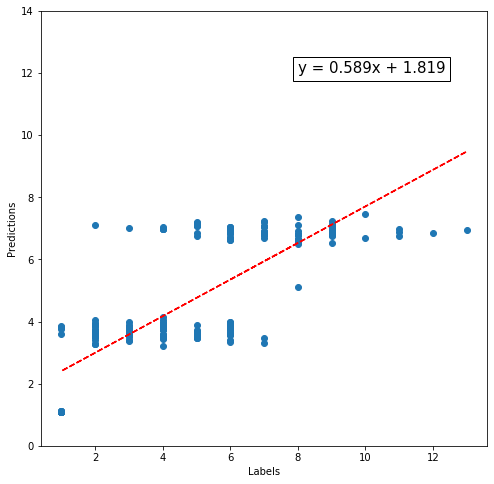

In [69]:
# visualization of prediction
from mlxtend.plotting import plot_linear_regression

m, b = np.polyfit(y_test, X_pred, 1)
eq = 'y = ' + str(round(m, 3)) + 'x + ' + str(round(b, 3))
plt.subplots(figsize=(8,8))
plt.scatter(y_test, X_pred)
plt.ylim(0,14)
plt.plot(np.array(y_test), m*np.array(y_test) + b, color='red', linestyle='dashed')
plt.text(8,12, eq, fontsize='15', bbox=dict(boxstyle='square', color='black', fc='none'));
plt.xlabel('Labels')
plt.ylabel('Predictions')

In [70]:
#AUC score equivalent (precision more accurate for unbalanced dataset)
from sklearn.metrics import average_precision_score

y_pred, y_label = binerize_labels(X_pred, y_test)
ls_score_svr.append(average_precision_score(y_label, y_pred))

In [71]:
from sklearn import metrics
from sklearn.metrics import roc_curve, auc

fpr_svr, tpr_svr, _ = metrics.roc_curve(y_label, y_pred)#, pos_label=2)
roc_auc_svr = auc(fpr_svr, tpr_svr)

In [72]:
#checking prediction
score_check = pd.DataFrame(columns=["Pred_raw", "Label_raw", "Abs_diff", "Pred", "Label", "Score"])
score_check["Pred_raw"], score_check["Label_raw"] = X_pred, y_test
score_check["Abs_diff"] = abs(X_pred - y_test)
score_check["Pred"], score_check["Label"] = binerize_labels(X_pred, y_test)
score_check["Score"] = score_check["Pred"] == score_check["Label"]
score_check

,Pred_raw,Label_raw,Abs_diff,Pred,Label,Score
0,6.822014,8,1.177986,1,1,True
1,3.603262,6,2.396738,0,1,False
2,6.663965,6,0.663965,1,1,True
3,4.150642,4,0.150642,0,0,True
4,6.742952,11,4.257048,1,1,True
...,...,...,...,...,...,...
193,7.049361,9,1.950639,1,1,True
194,3.579456,6,2.420544,0,1,False
195,1.101657,1,0.101657,0,0,True
196,1.105390,1,0.105390,0,0,True


In [73]:
scores = score_check.describe()

ls_score_svr.append(roc_auc_svr)
ls_score_svr.append("%0.3f (+/- %0.3f)" % (scores["Abs_diff"][1], scores["Abs_diff"][2]))

In [74]:
ls_score_svr

['SVR',
 0.8232323232323232,
 0.8042076538808565,
 0.8262867647058824,
 '1.290 (+/- 1.128)']

## Stochastic Gradient Descent Classifier prediction

In [75]:
from sklearn.linear_model import SGDClassifier

clf = SGDClassifier(loss="hinge", penalty="l2", max_iter=100)
clf.fit(cX_train, y_train)

SGDClassifier(alpha=0.0001, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.0, fit_intercept=True,
              l1_ratio=0.15, learning_rate='optimal', loss='hinge',
              max_iter=100, n_iter_no_change=5, n_jobs=None, penalty='l2',
              power_t=0.5, random_state=None, shuffle=True, tol=0.001,
              validation_fraction=0.1, verbose=0, warm_start=False)

In [76]:
# 10-fold CV
X_pred = cross_val_predict(clf, cX_test, y_test, cv=10)
X_pred

C:\Users\jongm\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:667: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=10.
  % (min_groups, self.n_splits)), UserWarning)


array([ 4,  3,  7,  6,  6,  6,  2,  3,  2,  6,  1,  1,  4,  1,  3,  7,  1,
        2,  7,  3,  7,  8,  4,  5,  8,  7,  1,  7,  4,  5,  3,  3, 10,  3,
       10,  2,  2,  2,  7,  5,  2,  7,  6,  9, 10,  6,  3,  2,  6,  6,  2,
        7, 10,  7,  7,  7,  2,  7,  5,  8,  2, 10,  6,  6,  4,  2,  8,  6,
        1,  1, 10,  5,  7,  5,  6,  1,  8,  2,  6,  2,  2,  3,  1,  9,  1,
        2, 10,  9,  5,  7, 10,  3,  3,  4,  2,  1,  4,  1,  8,  5,  7,  7,
        6,  8,  4,  9,  2,  1,  1,  2,  2,  8,  2,  4,  8,  5,  2,  6,  5,
        2,  4, 11,  6,  8,  7,  6,  7,  9,  8,  5,  6,  1,  6,  3,  2,  4,
        3,  5,  7,  8,  3,  7,  7,  9,  1,  9,  7,  9,  9,  5,  4,  7,  1,
        2,  6,  3,  2,  2,  3,  4,  1,  3,  3,  3,  4,  2,  2,  1,  4,  2,
        1,  8,  4,  2,  4,  1,  1, 13,  3,  2,  7,  3,  9,  8,  6,  9,  1,
        3,  2,  1,  1,  6,  1,  7,  2,  1,  1, 12])

Text(0, 0.5, 'Predictions')

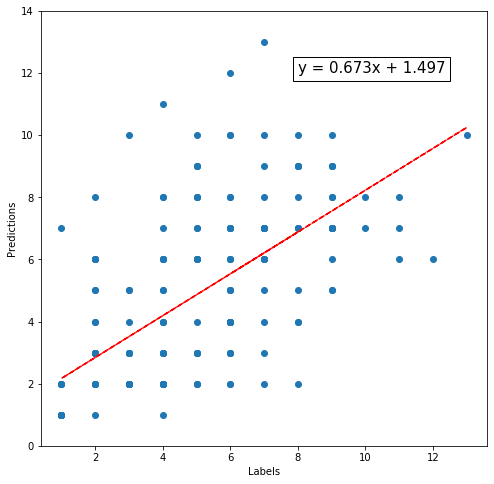

In [77]:
# visualization of prediction
from mlxtend.plotting import plot_linear_regression

m, b = np.polyfit(y_test, X_pred, 1)
eq = 'y = ' + str(round(m, 3)) + 'x + ' + str(round(b, 3))
plt.subplots(figsize=(8,8))
plt.scatter(y_test, X_pred)
plt.ylim(0,14)
plt.plot(np.array(y_test), m*np.array(y_test) + b, color='red', linestyle='dashed')
plt.text(8,12, eq, fontsize='15', bbox=dict(boxstyle='square', color='black', fc='none'));
plt.xlabel('Labels')
plt.ylabel('Predictions')

In [78]:
ls_score_sgd = ['SGD']

In [79]:
ls_score_sgd.append(compute_accuracy(X_pred, y_test))

In [80]:
#X_pred = clf.predict(cX_test)
y_pred, y_label = binerize_labels(X_pred, y_test)
ls_score_sgd.append(average_precision_score(y_label, y_pred))

In [81]:
fpr_SGD, tpr_SGD, _ = metrics.roc_curve(y_label, y_pred)#, pos_label=2)
roc_auc_SGD = auc(fpr_SGD, tpr_SGD)

In [82]:
#checking prediction
score_check = pd.DataFrame(columns=["Pred_raw", "Label_raw", "Abs_diff", "Pred", "Label", "Score"])
score_check["Pred_raw"], score_check["Label_raw"] = X_pred, y_test
score_check["Abs_diff"] = abs(X_pred - y_test)
score_check["Pred"], score_check["Label"] = binerize_labels(X_pred, y_test)
score_check["Score"] = score_check["Pred"] == score_check["Label"]
score_check

,Pred_raw,Label_raw,Abs_diff,Pred,Label,Score
0,4,8,4,0,1,False
1,3,6,3,0,1,False
2,7,6,1,1,1,True
3,6,4,2,1,0,False
4,6,11,5,1,1,True
...,...,...,...,...,...,...
193,7,9,2,1,1,True
194,2,6,4,0,1,False
195,1,1,0,0,0,True
196,1,1,0,0,0,True


In [83]:
scores = score_check.describe()

ls_score_sgd.append(roc_auc_SGD)
ls_score_sgd.append("%0.3f (+/- %0.3f)" % (scores["Abs_diff"][1], scores["Abs_diff"][2]))

In [84]:
ls_score_sgd

['SGD',
 0.7626262626262627,
 0.7151012857501639,
 0.7631740196078431,
 '1.717 (+/- 1.612)']

## Prediction comparison

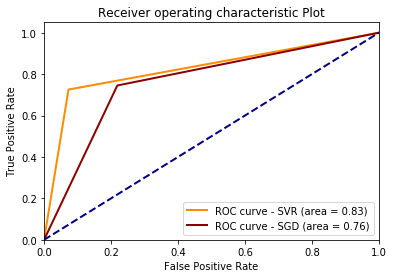

In [85]:
import matplotlib.pyplot as plt

plt.figure()
lw = 2
plt.plot(fpr_svr, tpr_svr, color='darkorange',
         lw=lw, label='ROC curve - SVR (area = %0.2f)' % roc_auc_svr)
plt.plot(fpr_SGD, tpr_SGD, color='darkred',
         lw=lw, label='ROC curve - SGD (area = %0.2f)' % roc_auc_SGD)
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic Plot')
plt.legend(loc="lower right")
plt.show()

In [86]:
# comparison table here
tb_pred = pd.DataFrame(columns=['Model', 'Accuracy', 'Precision', 'AUC', 'Error [Mean (+/- 1SD)]'])
tb_pred.loc[0] = ls_score_svr
tb_pred.loc[1] = ls_score_sgd
tb_pred

,Model,Accuracy,Precision,AUC,Error [Mean (+/- 1SD)]
0,SVR,0.823232,0.804208,0.826287,1.290 (+/- 1.128)
1,SGD,0.762626,0.715101,0.763174,1.717 (+/- 1.612)


## Manhattan plot for high-risk and low-risk users

* "Background" noise (ie genes) is removed
* p-value calcluated by student t-test

In [87]:
#changing threshold for maximal differentiation
RISK_GENE_THRESHOLD = 8

In [88]:
#list of high risk group
high_users, low_users = select_high(gene_byuser, risk_score)
high_users.head(100)

,genome_Logan_Robinson_Full_20140903230050.txt(8),23andmeFULLGENOME20130820115638.txt(12),genome_Full_20150222.txt(9),23andMe (4).txt(10),23andme_genome_hu4CFB79_Full_20130722133713.txt(9),hu8D6607_20120913172612.txt(8),genome_Full_20130324084949.txt(9),genome_mario_ricci_v3_Full_20160712125931.txt(9),genome_Stephen_Duff_Full_20131101123509.txt(10),genome_Darin_Douma_Full_20151116114545.txt(8),genome_Dan_Salazar_Full_20140302074628.txt(11),23andMe_genome_Full_20130702074843.txt(13),genome_simon_convey_Full_20130516103652.txt(8),genome_hu1A57E4_23andMe.txt(9),23andMe.txt(14),genome_LR_Full_20131202071756.txt(9),genome_David_Glazer_Full_20140202085913.txt(8),genome_Paul_Conroy_Full_20121114161312.txt(9),genome_John_Williams_Full_20160215160820.txt(8),genome_Michelle_Grogan_v5_Full_20180406084128.txt(9),23andme (3).txt(9),genome (1).txt(8),genome_CK_Full_20140317185824.txt(9),genome (12).txt(11),genome_huCFF045_Full_20140318110911.txt(8),genome_NAME_REDACTED_Full_20150403101041.txt(12),genome_Beth_Stiner_Full_20140827150917[1].txt(8),full23andmedata.txt(8),genome_Jeffrey_Marquardt_Full_20140509054425.txt(8),genome_Claudia_Pereira_Full_20141226152559.txt(8),hu916767_20170324191934.txt(10),genome_Ramona_Bates_Full_20130313134111.txt(8),23andme_huB4E868_20140302121422.txt(9),genome_Aaron_Hill_v3_Full_20191101162607.txt(8),genome_Rachel_Carlsen_Full_20130501103013.txt(8),genome_John_Bylander_Full_20130607165442.txt(9),genome_Full_20121016173618.txt(9),genome_Full_20131028233806.txt(10),genome (2).txt(8),genome_Lenny_Zimmermann_Jr__Full_20131109110434.txt(8),genome_Michael_Kountz_Full_20140302061047.txt(8),20140624155119.txt(8),genome_Thomas_Hazzard_Full_20131126112222.txt(9),genome_Full_20130529095334.txt(8),genome_Brian_LeBaron_Full_20121211113924.txt(9),23&me_data_for_hu1A8107.txt(9),dna.txt(8),hu09D626_20130314162205.txt(8),exome_genotype.txt(8),genome_23andme_Full_20140302072330.txt(9),genome_Kathleen_Reed_Full_20130620121615.txt(8),genome_Alana_Lynch_Full_20131022125708.txt(9),genome_Full_20131118115943.txt(10),genome_hu4BA913_Full_20150215165330.txt(9),genome_23andMe_Full_Data_20130616.txt(9),genome_Frances_Woodward_Full_20150222145516.txt(8),genome_hu3DC5EA_20140306083950.txt(13),huF8AEC7_20130505233424.txt(10),genome_mario_ricci_Full_20151111094730.txt(9),genome_Full_20130211121833.txt(9),genome_SJB_Full_20141203054745.txt(8),genome_PNA_v2_v3_v5_Full_20190801102941.txt(9),genome_Joshua_Johnson_Full_20141013153834.txt(9),genome_CAA_v2_v3_v5_Full_20190731171138.txt(9),23andMeGenome_1.txt(11),genome_Peter_Breen_Full_20130319171658.txt(9),genome_v3_Full_20170609044919.txt(8),genome_Daniel_Dye_Full_20160226183353.txt(8),hu1EE386_20121011193852.txt(8),genome_Rachel_Parnell_Full_20121212075313.txt(9),23&Me_Genotyping.txt(9),genome_Full_20121117005042.txt(8),hu5BB600_20170422005743.txt(12),genome_Diana_Cleaveland_Full_20130407090851.txt(9),23andme_data (1).txt(8),23andme_Genome_hu12D62A.txt(9),genome_jh_Full_20140201170820.txt(11),genome_Joseph_Roberts_Full_20130902122603.txt(9),23andMe_data.txt(10),genome_Craig_Falls_Full_20140720192139.txt(8),genome_Rachel_Tharp_v5_Full_20180312120159.txt(8),genome_Cheri_Smith_Full_20140502235633.txt(9),genome_James_Melvin_Baber_Full_20120928141522.txt(8),genome_Joshua_Berk_v3_Full_20160506230738.txt(9),23_and_me_data.txt(8),genome_Douglas_R_Full_20130114135651.txt(9),genome_Robin_Craig_Full_20151204190611.txt(9),genome.txt(10),genome_v3_Full.txt(9),genome_Garry_Grosse_Full_20121218124942.txt(8),genome_Finnegan_Marsh_Full_20140528100215.txt(8),genome_mydata_Full_20130801202914.txt(9),genome_Jill_W__Full_20121011080746.txt(8),genome_Dana_Herbert_Full_20140710001816.txt(10),genome_Alyssa_Beemer_v3_Full_20171127095353.txt(8),genome_Full_20150922002255.txt(9),genome_Hugh_Durkan_v3_Full_20171207103929.txt(8),23andMe_Full_20140502164209.txt(8),genome_pgp_Full_20150909224409.txt(12),genome_Full_20121110170538.txt(8),genome_Ryan_Rafols_Full_20150814010444.txt(8),genome_Full_20140126181553.txt(8),genome_Mar

In [89]:
high_users_nobg = subtract_background(high_users, df_common)
low_users_nobg = subtract_background(low_users, df_common)

100.0 % completed


In [90]:
def extract_genes(df):
 
    ls = [[0]*len(dic_genelist) for _ in range(len(df.columns))]
    
    for i in df.columns:
        
        for j in range(len(df[i])):
            
            fchar = str(df.at[j, i]).rfind("(")

            if fchar is not -1 and ":" not in df.at[j, i][:fchar]:
                fnum = int(df.at[j, i][fchar+1:-1])
                ls[df.columns.to_list().index(i)][dic_genelist[df.at[j,i][:fchar]]] = fnum
    
        progress(df, i)
    
    return ls    

In [91]:
#generating gene:chromosome pair dictionary
dic_gene_chr = {}

for i in dic_genelist.keys():
    dic_gene_chr[i] = list(df[df['Hugo'] == i]['Chrom'][:1])[0]

In [92]:
%%time
#chi2_X = extract_genes(gene_byuser_nobg.iloc[:, 1:-1])
chi2_X_high = extract_genes(high_users_nobg)
chi2_X_low = extract_genes(low_users_nobg)

100.0 % completed
Wall time: 33.6 s


In [93]:
#binarized risk score
bin_risk_score = [1 if risk_score[i] >= RISK_GENE_THRESHOLD else 0 for i in range(len(risk_score))]

In [94]:
#producing p-value via student t-test
from scipy import stats

_, p2_high = stats.ttest_ind(chi2_X_high,risk_score)
_, p2_low = stats.ttest_ind(chi2_X_low,risk_score)

#chi square implementation (error)
# from sklearn.feature_selection import chi2

# chi2_score , pval_score = chi2(chi2_X,risk_score)

In [95]:
#rs > binarize > each user > risk_score
#SNP | P-val | chr
def construct_mdf(p2):
    
    #removing errored values
    p3 = list(p2)
    p2 = [1 if p3[i] == 0 else p3[i] for i in range(len(p3))]
    
    chi2_df = pd.DataFrame(columns=["Gene", "chi2", "chr"])
    chi2_df['Gene'] = dic_genelist.keys()
    chi2_df['chi2'] = p2
    chi2_df['chr'] = dic_gene_chr.values()
    
    return chi2_df

In [96]:
chi2_df_high = construct_mdf(p2_high)
chi2_df_low = construct_mdf(p2_low)

In [97]:
#range of p-values
ls_min_max = [chi2_df_high['chi2'].max(),
             chi2_df_high['chi2'].min(),
             chi2_df_low['chi2'].max(),
             chi2_df_low['chi2'].min()]

ls_min_max

[0.9811227387372328,
 1.1102330508285329e-162,
 0.7948840336762765,
 1.0019511890959278e-261]

In [98]:
ymax_h = -round(np.log10(ls_min_max[1]) * 1.2, -1)
ymax_l = -round(np.log10(ls_min_max[3]) * 1.2, -1)

Manhattan plot for high-risk users


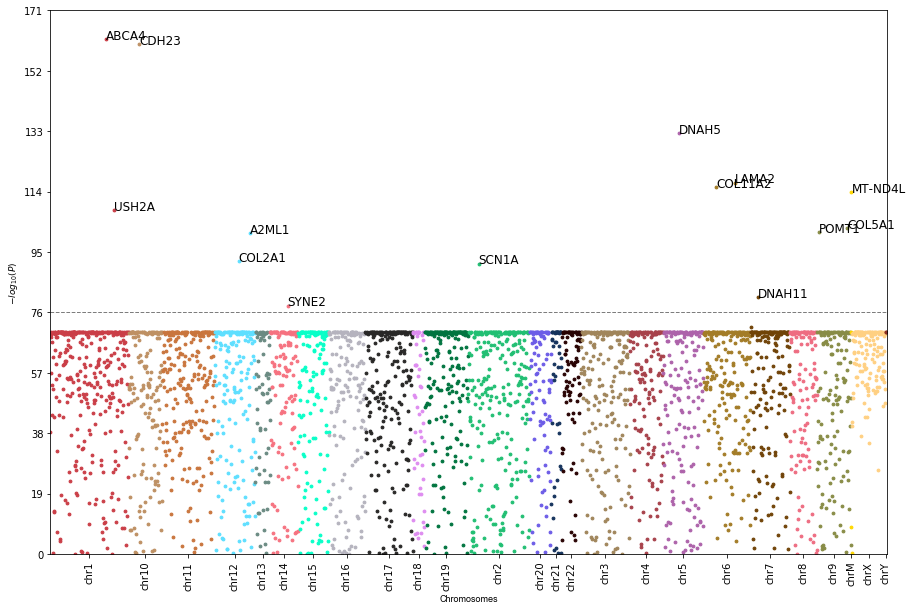

Manhattan plot for low-risk users


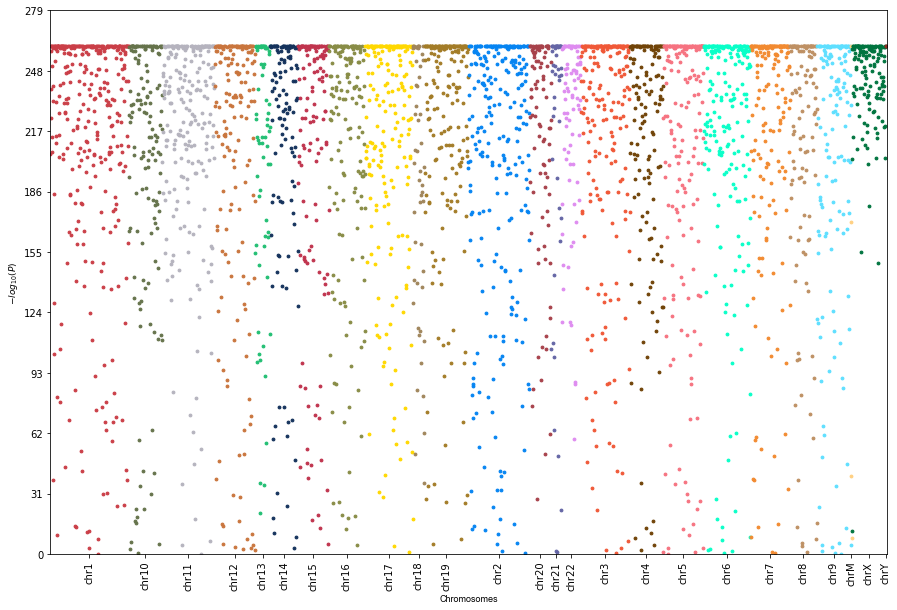

In [99]:
from bioinfokit import visuz, analys

df_mhat = analys.get_data('mhat').data

print("Manhattan plot for high-risk users")
visuz.marker.mhat(df=chi2_df_high, chr='chr',pv='chi2', show=True, gwas_sign_line=True, gfont=12,
                  markernames=True, markeridcol='Gene', dim=(15, 10), 
                   gwasp=1*10**(-ymax_h * 0.4), ylm=(0,ymax_h,ymax_h/10))#, ylm=(1,1E-318,1E-10), gstyle=2) 

print("Manhattan plot for low-risk users")
visuz.marker.mhat(df=chi2_df_low, chr='chr',pv='chi2', show=True, gwas_sign_line=True, gfont=12,
                  markernames=True, markeridcol='Gene', dim=(15, 10), 
                  gwasp=1*10**(-ymax_l * 0.99), ylm=(0,ymax_l,ymax_l/10))#ylm=(1,1E-318,1E-10)) 

## <u>Reference</u>

1.	Heron, M., Deaths: Leading Causes for 2016. Natl Vital Stat Rep, 2018. 67(6): p. 1-77.
2.	Poblador-Plou, B., et al., Comorbidity of dementia: a cross-sectional study of primary care older patients. BMC Psychiatry, 2014. 14: p. 84.
3.	Giri, M., M. Zhang, and Y. Lu, Genes associated with Alzheimer's disease: an overview and current status. Clin Interv Aging, 2016. 11: p. 665-81.
4.	Pagel, K.A., et al., Integrated Informatics Analysis of Cancer-Related Variants. JCO Clin Cancer Inform, 2020. 4: p. 310-317.
5.	Reitz, C., et al., A summary risk score for the prediction of Alzheimer disease in elderly persons. Arch Neurol, 2010. 67(7): p. 835-41.
6.	Lanoiselee, H.M., et al., APP, PSEN1, and PSEN2 mutations in early-onset Alzheimer disease: A genetic screening study of familial and sporadic cases. PLoS Med, 2017. 14(3): p. e1002270.
7.	Loughrey, D.G., M.A. Parra, and B.A. Lawlor, Visual short-term memory binding deficit with age-related hearing loss in cognitively normal older adults. Sci Rep, 2019. 9(1): p. 12600.